# System Reload

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import statistics
import re
import os
from datetime import datetime, timedelta
import pytz

import warnings
warnings.filterwarnings("ignore")
import psychrolib
from pythermalcomfort.models import pmv_ppd
from pythermalcomfort.utilities import v_relative, clo_dynamic

In [2]:
from sklearn.model_selection import train_test_split, KFold, cross_val_predict
from sklearn import metrics, tree
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.naive_bayes import CategoricalNB, GaussianNB
from sklearn import svm
from sklearn import neighbors, datasets
from sklearn.svm import SVR, SVC
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier, ExtraTreesClassifier,StackingRegressor, ExtraTreesRegressor, AdaBoostClassifier, AdaBoostRegressor , GradientBoostingClassifier, GradientBoostingRegressor
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.datasets import make_regression
import xgboost as xg
from scipy.stats import linregress
from xgboost.sklearn import XGBClassifier, XGBRegressor
from sklearn.neural_network import MLPRegressor, MLPClassifier
from sklearn.multioutput import MultiOutputRegressor, MultiOutputClassifier
from sklearn.model_selection import GridSearchCV,train_test_split
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor, plot_tree
from sklearn.gaussian_process import GaussianProcessRegressor, GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.linear_model import LinearRegression, Lasso, Ridge, LogisticRegression
import statsmodels.api as sm
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

from collections import Counter
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler, SMOTE, SMOTENC, SMOTEN

from sklearn.preprocessing import StandardScaler, MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

import joblib
from joblib import dump, load

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, explained_variance_score, mean_absolute_percentage_error, root_mean_squared_error


# Default Names & Setting

In [3]:
#filtering rows data regarding to desired specific time
start_time = '06:00'
end_time   = '18:00'
start_date = '2023-03-06'
end_date   =  '2024-05-30'

spec_date = pd.to_datetime('today').strftime("%Y-%m-%d")
#name_date = pd.to_datetime('today').strftime("%y%m%d")
date_format_show =  '%Y-%m-%d'
time_format_show =  '%H:%M'
start_day  = 0
end_day    = 7
start_hour = 0
end_hour   = 24

# tell resample data
time_series_resample = '10min'     #for Processor 1
survey_resample      = '1H'     #for Processor 2
desample_option      = '1H'
minutely_resample    = '1min'

In [4]:
# Folder Naming
folder_raw     = 'data-raw'
folder_ready   = 'data-ready'
folder_year    = '2023'
folder_project = 'project'
folder_export  = 'export'
folder_is      = 'niluapp'
data_for1      = 'combined panel'
data_for2      = 'combined longitudinal'
platform_directory = 'C:/Users/azimilga'

col_header = ['title', 'sessionid', 'date', 'time' ]
response_counting = ['responses']
is_col_main  =  ['feel_air','feel_temp','feel_health','feel_bright','feel_noise']
is_col_main1  = ['feel_air1','feel_temp1','feel_health1','feel_bright1'] #,'feel_noise1'
is_col_main2  = ['feel_air2','feel_temp2','feel_health2','feel_bright2'] #,'feel_noise2'
is_col_main3  = ['feel_air3','feel_temp3','feel_health3','feel_bright3'] #,'feel_noise3'
is_col_main4  = ['feel_air4','feel_temp4','feel_health4','feel_bright4'] #,'feel_noise4'

is_main_air    = ['feel_air1', 'feel_air2', 'feel_air3', 'feel_air4']
is_main_temp   = ['feel_temp1', 'feel_temp2', 'feel_temp3', 'feel_temp4']
is_main_bright = ['feel_bright1', 'feel_bright2', 'feel_bright3', 'feel_bright4']
is_main_health = ['feel_health1', 'feel_health2', 'feel_health3', 'feel_health4']
is_main_noise  = ['feel_noise1', 'feel_noise2', 'feel_noise3', 'feel_noise4']

is_col_air   = ['air_smell','air_heavy','air_dry','air_dust','air_electshock']
is_col_temp  = ['temp_coldhot','temp_draw','temp_coldfloor','temp_heatsun','temp_heater' ]
is_col_bright = ['bright_sun','bright_lamp_hi','bright_lamp_low']
is_col_health  = ['health_head','health_cough','health_tired','health_dryskin']
is_col_multi  = ['feel_air','feel_temp','feel_health','feel_bright','feel_noise','temp_coldhot']
is_col_subquestion = is_col_air+ is_col_temp + is_col_bright + is_col_health
pd_col       = ['pd_air', 'pd_temp', 'pd_health', 'pd_bright', 'pd_noise']
columns_formation   = col_header + is_col_main + is_col_air + is_col_temp + is_col_bright + is_col_health

school_col_name   = 'school_id'
room_col_name     = 'room_id'
date_name         = 'date'
time_name         = 'time'
manuf_col_name    = 'manuf_id'
instr_col_name    = 'instr_id'
serial_col_name   = 'serial_id'

#Give a name for new column in purpose to count how many response / hour or response / day
response_counting = 'responses'

#columns_formation = ['title', 'sessionid', 'date', 'time' , 'Room Air', 'Room Temperature', 'Room Lighting', 'Health Feeling', 'Room Noice', 'BAD SMELL' , 'BAD HEAVY/AIR', 'DRY AIR', 'DUST AND DIRT', 'ELECTRIC SHOCK', '(-COLD) OR HOT', 'DRAWING COLD AIR', 'COLD ON THE FLOOR', 'MUCH HEAT FROM SUNSHINE', 'MUCH HEAT FROM FURNACES', 'LIGHT FROM THE SUN', 'BRIGHT LIGHT CEILING LAMPS', 'WEAK LIGHT CEILING LAMPS', 'HEADACHE', 'COUGH/SHORENESS', 'TIRED/UNCONCENTRATED', 'DRY EYES/HANDS']


word_indoor   = 'Indoor '
word_outdoor  = 'Outdoor ' 
temp_v_label  = word_indoor+ 'Temp. (*C)'
co2_v_label   = word_indoor+ 'CO2 level  (ppm)'
vent_v_label  = word_indoor+ 'Supply Air (CMH)'
temp_a_label  = word_indoor+ 'Temp. (*C)'
rh_a_label    = word_indoor+ 'Relative Humidity (%)'
co2_a_label   = word_indoor+ 'CO2 level (ppm)'
voc_a_label   = word_indoor+ 'VOC contaminant level (ppb)'
bright_a_label= word_indoor+ 'Luminous Intensity (%)'
sound_a_label = word_indoor+ 'Sound Pressure Intensity (Pa)'
pm25_a_label  = word_indoor+ 'PM2.5 density (ug/m3)'
pm1_a_label   = word_indoor+ 'PM1.0 density (ug/m3)'
rdn_a_label   = word_indoor+ 'Radon Level (Bq/m3)'
press_a_label = word_indoor+ 'Air pressure (hPa)'
swc_f_label   = word_indoor+ 'Floor Heater -On/Off'
swc_r_label   = word_indoor+ 'Baseboard Heater-On/Off'
temp_f_label  = word_indoor+ 'Floor Temperature (*C)'
temp_o_label  = word_outdoor+ 'Temperature (*C)'
rh_o_label    = word_outdoor+ 'Relative Humidiy (%)'
winds_o_label = word_outdoor+ 'Wind Speed (m/s)'
sun_o_label   = word_outdoor+ 'Mean Global Radiation (W/m2)'
pm25_o_label  = word_outdoor+ 'PM2.5 density (ug/m3)'
pm10_o_label  = word_outdoor+ 'PM10 density (ug/m3)'

directory_path = platform_directory +  '/' + folder_project + '/' + folder_ready   +  '/'   +  folder_year  + '/'

co2_name          = 'co2_a'
temp_data_name    = 'temp_a'
temp_out_name     = 'temp_o'
rel_hum_name      = 'rh_a'
rel_hum_out_name  = 'rh_o'
voc_name          = 'voc_a'
bright_name       = 'bright_a'
sound_name        = 'sound_a'
pm25_name         = 'pm2.5_a'
pm1_name          = 'pm1_a'
radon_name        = 'rdn_a'
press_name        = 'press_a'
press_out_name    = 'press_o'
enthalpy_name     = 'enth_a'
enthalpy_out_name = 'enth_o'
humid_ratio_name  = 'hura_a'
humid_ratio_out_name  = 'hura_o'
pm25_out_name = 'pm2.5_o'
pm10_out_name = 'pm10_o'
winds_out_name = 'winds_o'
rain_out_name = 'rain_o'



pmv_ppd_name      = [ 'pmv', 'ppd']
sun_out_name     = 'sun_o'
outdoor_polutant_data = [ pm25_out_name, pm10_out_name]

airthingsSmall = [co2_name, temp_data_name, rel_hum_name, press_name, enthalpy_name, humid_ratio_name, voc_name, bright_name]
airthingsPlus = airthingsSmall + [ radon_name] #+pmv_ppd_name
airthingsPro  = airthingsSmall +[  sound_name,pm1_name, pm25_name]   #+ pmv_ppd_name
airthingsPro_i = ['co2_i', 'temp_i', 'rh_i', 'press_i', 'enth_i', 'hura_i', 'voc_i',
       'bright_i', 'sound_i', 'pm1_i', 'pm2.5_i']
weather_volda = [ temp_out_name, rel_hum_out_name, winds_out_name, rain_out_name,enthalpy_out_name, humid_ratio_out_name, press_out_name]
weather_oslo  = outdoor_polutant_data+ weather_volda +  [sun_out_name]
pollutant_extra = [ 'nox_o', 'no2_o', 'no_o']

In [5]:
weather_delay_1 = [f'{column}_1' for column in weather_oslo]
weather_delay_2 = [f'{column}_2' for column in weather_oslo]
weather_delay_3 = [f'{column}_3' for column in weather_oslo]
in_pm_delay_1 = ['pm1_a_1', 'pm2.5_a_1']
in_pm_delay_2 = ['pm1_a_2', 'pm2.5_a_2']
in_pm_delay_3 = ['pm1_a_3', 'pm2.5_a_3']
in_pm_delay_all = in_pm_delay_1 + in_pm_delay_2 + in_pm_delay_3
out_pm_delay_1 = ['pm10_o_1', 'pm2.5_o_1']
out_pm_delay_2 = ['pm10_o_2', 'pm2.5_o_2']
out_pm_delay_3 = ['pm10_o_3', 'pm2.5_o_3']
out_pm25_delay_all = ['pm2.5_o_1', 'pm2.5_o_2', 'pm2.5_o_3']
out_pm10_delay_all = ['pm10_o_1', 'pm10_o_2', 'pm10_o_3']
out_pm_delay_all = out_pm_delay_1 + out_pm_delay_2 + out_pm_delay_3

Time Zone Changing (GMT to OSLO)

In [6]:
 #convert time format to datetime  : time_zone_converter (df, 'Zone Origin', 'Zone Destination')
def time_zone_converter(df, zone_origin, zone_destination):
  #df['datetime'] = pd.to_datetime((df['date'] + ' ' + df['time']), format='%Y-%m-%d %H:%M:%S')
  #df['DateTime'] = datechange.dt.strftime('%Y-%m-%d %H:%M:%S')

  df['datetime'] = pd.to_datetime(df['datetime'])
  df['date'] = df['datetime'].dt.strftime('%Y-%m-%d')

  # Define the timezones (GMT and Europe/Oslo)
  origin_timezone = pytz.timezone(zone_origin)
  destination_timezone = pytz.timezone(zone_destination)

  # Adjust the datetime to the Oslo timezone and account for daylight saving time
  df['adjusted datetime'] = df['datetime'].dt.tz_localize(origin_timezone, ambiguous='NaT', nonexistent='NaT').dt.tz_convert(destination_timezone)

  # Extract the adjusted time
  df['time'] = df['adjusted datetime'].dt.strftime('%H:%M')
  df['datetime'] = df['adjusted datetime'] #.dt.strftime('%Y-%m-%d %H:%M')
  df.drop(['adjusted datetime'], axis=1, inplace=True)

In [7]:
# Create a heatmap for the pearsons/spearman coefficient
def heatmap_corrvalue (df, corr_method , size , title, font_size):
    corr = df.corr(method=corr_method).round(2)   #, 'feel_bright'

    # Generate a mask for the upper triangle
    mask = np.zeros_like(corr)
    mask[np.triu_indices_from(mask)] = True

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=size)

    plt.xticks(rotation=90, fontsize=font_size)
    plt.title('correlation map : '+ '(' + corr_method + ') '+title , fontsize=12)
    plt.yticks(fontsize=font_size,rotation=90 )

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(22,10, as_cmap=True)

    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(corr, mask=mask,cmap="RdYlGn", vmin=-1, vmax=1, center=0, cbar=True, annot =True,
                square=True, linewidths=.5, annot_kws={"size": (font_size-2)})

In [8]:
def datetime_indexer(df):
    df['datetime'] = pd.to_datetime((df['date'] + ' ' + df['time']), format='%Y-%m-%d %H:%M')
    df.set_index(['datetime'], inplace = True)

def datetime_indexer_noindex(df):
    df['datetime'] = pd.to_datetime((df['date'] + ' ' + df['time']), format='%Y-%m-%d %H:%M')
    #df.set_index(['datetime'], inplace = True)

def datedayhour_creator(df) :
  df.reset_index( inplace = True)
  datechange = pd.to_datetime(df['datetime'])
  df['date'] = datechange.dt.strftime('%Y-%m-%d')
  df['day']  = datechange.dt.dayofweek
  df['hour'] = datechange.dt.hour

def datedayhour_creator_noindex(df) :
  datechange = pd.to_datetime(df['datetime'])
  df['date'] = datechange.dt.strftime('%Y-%m-%d')
  df['day']  = datechange.dt.dayofweek
  df['hour'] = datechange.dt.hour

def date_selector(df,start_date,end_date) :
  df.reset_index( inplace = True)
  datechange = pd.to_datetime(df['datetime'])
  df['date'] = datechange.dt.strftime('%Y-%m-%d')
  df         = df[(df['date']>=start_date) & (df['date']<=end_date)]
  df         = df.drop('date', axis=1).set_index('datetime')
  

def pmv_ppd_generator(df):
  tdb = df['temp_a'].values
  tr = tdb
  vel = 0.05
  rh = df['rh_a'].values
  met = 1.2
  clo = 0.67

  v_rel = v_relative(vel, met)
  clo_d = clo_dynamic(clo, met)
  results = pmv_ppd( tdb=tdb, tr=tr ,vr=v_rel, rh= rh, met=met, clo=clo_d,standard= 'iso', units= 'SI')
  df['pmv'] = results['pmv']
  df['ppd'] = results['ppd']/100

In [9]:
def create_delayed_features(df, columns, delays):
    for col in columns:
        for delay in range(1, delays + 1):
            df[f'{col}_{delay}'] = df[col].shift(delay)
    df.dropna(inplace=True) # fillna(0, inplace=True)  # Fill NaNs with 0 or handle them appropriately
    return df

In [10]:
def ML_optimization_process (find_optimum, ML_optimum, x_train, y_train, x_test,y_test):
  print("Optimum Value : {}".format(find_optimum))
  print("Accuracy score (training): {:.3f}".format(ML_optimum.score(x_train, y_train)))
  print("Accuracy score (validation): {:.3f}".format(ML_optimum.score(x_test, y_test)))
  print("__")

def ML_optimization_process_CV (find_optimum, ML_optimum, x_train, y_train, x_test,y_test):
  print("Optimum Value : {}".format(find_optimum))
  print("CV score (training): {:.3f}".format((root_mean_squared_error(ML_optimum.predict(x_train).reshape(-1,1), y_train)/np.array(y_train).flatten().mean(axis=0)).round(3)))
  print("CV score (validation): {:.3f}".format((root_mean_squared_error(ML_optimum.predict(x_test).reshape(-1,1), y_test)/np.array(y_test).flatten().mean(axis=0)).round(3)))
  # print("CV score (all): {:.3f}".format((root_mean_squared_error(ML_optimum.predict(X).reshape(-1,1), y)/np.array(y).flatten().mean(axis=0)).round(3)))
  # print("CV score (sahara): {:.3f}".format((root_mean_squared_error(ML_optimum.predict(Xs).reshape(-1,1), y)/np.array(ys).flatten().mean(axis=0)).round(3)))
  print("__")
  
#  np.sqrt(mean_squared_error(y_train,y_train_pred_DTR)).round(3)
def ML_NN_optimization_process (find_optimum1, find_optimum2, ML_optimum, x_train, y_train, x_test,y_test):
  print("Optimum Value : {}".format([find_optimum1,find_optimum2]))
  print("Accuracy score (training): {:.3f}".format(ML_optimum.score(x_train, y_train)))
  print("Accuracy score (validation): {:.3f}".format(ML_optimum.score(x_test, y_test)))
  print("__")

def ML_grid_result (grid_search, ML_optimum, x_train, y_train, x_test,y_test):
  print("Best parameters: ", grid_search.best_params_)
  print("Best score: ", grid_search.best_score_.round(3))
  print("Accuracy score (training): {:.3f}".format(ML_optimum.score(x_train, y_train)))
  print("Accuracy score (validation): {:.3f}".format(ML_optimum.score(x_test, y_test)))

In [11]:
def evaluate_models(models, model_names, X_data, y_data, for_what):
    """
    Evaluate machine learning models and return a DataFrame with performance metrics.

    Parameters:
    - models (list): List of trained model instances.
    - model_names (list): List of names corresponding to the models.
    - X_data (pd.DataFrame): Feature data for evaluation.
    - y_data (pd.Series or np.array): True target values for evaluation.

    Returns:
    - pd.DataFrame: DataFrame containing R-squared, MSE, MAE, and RMSE for each model.
    """
    
    # Initialize lists to store results
    r2_values = []
    mse_values = []
    mae_values = []
    rmse_values = []
    cv_values = []

    # Calculate metrics for each model
    for model in models:
        y_pred = model.predict(X_data)
        
        r2 = r2_score(y_data, y_pred).round(3)
        mse = mean_squared_error(y_data, y_pred).round(3)
        mae = mean_absolute_error(y_data, y_pred).round(3)
        rmse = np.sqrt(mse).round(3)
        cv_value = (rmse/(np.array(y_data).flatten().mean(axis=0))).round(3)
        
        r2_values.append(r2)
        mse_values.append(mse)
        mae_values.append(mae)
        rmse_values.append(rmse)
        cv_values.append(cv_value)

    # Create a DataFrame with the results
    results_df = pd.DataFrame({
        'Model '+for_what : model_names,
        'R2': r2_values,
    #    'MSE': mse_values,
     #   'MAE': mae_values,
        'RMSE': rmse_values,
        'CV' : cv_values
    })

    return results_df

In [12]:
def estimate_predictions(models, model_names, x_train, y_train,names):
    # if len(models) != len(model_names):
    #     raise ValueError("Length of models and model_names must be the same")

    # Initialize the result DataFrame with the actual y_train values
    result_df = pd.DataFrame(np.array(y_train).flatten(), columns=['y_' + names])

    # Add the predicted values for each model
    for model, name in zip(models, model_names):
        result_df[name] = model.predict(x_train).reshape(-1,1)

    return result_df

In [13]:
# Function to compute R², RMSE, and MSE for given true and predicted values
def calculate_metrics(y_true, y_pred):
    r2 = r2_score(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    cv_value = rmse/y_true.mean(axis=0)
    return r2, rmse, cv_value

def evaluate_predictions(df, y_true_name, condition_name ):
    # Initialize an empty list to store the results
    results = []

    # Loop through each y_pred column and calculate the metrics
    for col in df.columns:
        if col != y_true_name:
            r2, rmse, cv_value = calculate_metrics(df[y_true_name], df[col])
            results.append({condition_name: col, 'R2': r2,'RMSE': rmse,  'CV': cv_value})

    # Convert the results to a DataFrame
    results_df = pd.DataFrame(results)
    return results_df

In [14]:
date_range = pd.date_range(start='9/6/2023', end='9/12/2023').astype(str)
date_range2 = pd.date_range(start='1/6/2024', end='1/21/2024').astype(str)

def sahara_period(row):
    if row['date'].isin(date_range2):
        return 1
    elif row['date'].isin(date_range):
        return 1
    else :
        return 0

In [15]:
def plot_timeseries_single(df, start_date, end_date, variable_name, label_name):
    data_plot = df.copy()
    data_plot['datetime'] = pd.to_datetime(data_plot['datetime'])
    data_plot = data_plot[data_plot['date'].between(start_date,end_date)]#.set_index(['datetime'])
    # Plotting the median line for 'pm2.5_o'
    sns.lineplot(x=data_plot['datetime'], y=data_plot[variable_name], color='blue', label='Indoor pm2.5')
    
    # sns.lineplot(data=data_plot, x=data_plot.index , y=variable_name, color='blue')
    plt.xticks(rotation=45)
    plt.ylabel(label_name)
    plt.show()
    plt.clf()

In [16]:
def plot_scatter_graph_single_regress (df,x_var, y_var, hue_list, fig_size1, fig_size2 , font_size, x_label, y_label, boolean_intercept)  :
    fig, ax = plt.subplots(figsize=(fig_size1, fig_size2))
    # Plot scatter plot with hue

        # Reshape for sklearn
    X = df[x_var].values.reshape(-1, 1)
    y = df[y_var].values

        # Create and fit the model
    model = LinearRegression(fit_intercept=boolean_intercept)
    model.fit(X, y)
        
        # Make predictions
    y_pred = model.predict(X)
        
        # Calculate R²
    r2 = r2_score(y, y_pred)
        
        # Get the slope and intercept
    slope = model.coef_[0]
    intercept = model.intercept_
    y_fit= X*slope + intercept   
        # Plot the regression line

        # Display the equation
    equation = f'y = {slope:.2f}x + {intercept:.2f} (R²={r2:.2f})'
    sns.scatterplot(data=df, x=x_var, y=y_var, hue=hue_list, legend='auto', )
    sns.move_legend(ax,loc='lower right')
    plt.plot(df[x_var], y_fit, color='black')

    plt.text(df[x_var].max()*0.05,df[y_var].max(), equation, fontsize=font_size, ha='left') #, ha='right'

    # Show plot
    # plt.title('PM level comparison', fontsize=font_size+1)
    plt.xlabel(x_label)
    plt.xlim( 0, df[x_var].max()*1.1)
    plt.ylim( 0, df[y_var].max()*1.1)
    plt.ylabel(y_label)
    plt.show()

In [17]:
def plot_scatter_thermalcomfort (data, particle_name, particle_lable, thermal_name, thermal_lable, what_hue,  fig_size ):
    data['dust_period'].replace({1:'yes', 0:'no'}, inplace=True)
    fig, ax = plt.subplots(figsize=fig_size)
    sns.scatterplot(data, y=particle_name, x=thermal_name, hue= what_hue, palette='tab10')
        # plt.xscale('log')
        # plt.yscale('log')
    p = np.polyfit(data[thermal_name], data[particle_name], 2)
    y_fit = np.polyval(p, data[thermal_name])
    r2 = r2_score(data[particle_name], y_fit)
    sns.move_legend(ax,loc='lower right')
    equation = f'y = {p[0]:.2f}x² + {p[1]:.2f}x + {p[2]:.2f}\nR² = {r2:.2f}'  #\nR² = {r2:.2f}'
    plt.plot(data[thermal_name], y_fit, color='black', label=f'Trend Line: {equation}')

    plt.text(0.05, 0.95, equation, fontsize=10, transform=plt.gca().transAxes,
            verticalalignment='top', bbox=dict(facecolor='white',  alpha=0.5))

    plt.xlabel(thermal_lable #+' ' +x
                )
    plt.ylabel(particle_lable#+' '+y
                )
    # plt.yticks(np.arange(data[particle_name].min(), data[particle_name].max(), step=(data[particle_name].max()-data[particle_name].min() ).round(1)/6))
    # plt.xticks(np.arange(data[thermal_name].min(), data[thermal_name].max(), step=(data[thermal_name].max()-data[thermal_name].min()).round(1)/6))
    plt.ylim(0, data[particle_name].max()*1.1)
    plt.xlim(0, data[thermal_name].max()*1.1)
    # plt.xscale('symlog')
    plt.show()
    plt.clf()

In [18]:
def plot_timeseries_allPM(df, start_date, end_date):
    data_plot = df.copy()
    data_plot['datetime'] = pd.to_datetime(data_plot['datetime'] )
    data_plot = data_plot[data_plot['date'].between(start_date,end_date)].set_index(['datetime'])
    # Plotting the median line for 'pm2.5_o'
    sns.lineplot(x=data_plot.index, y=data_plot[pm25_name], color='blue', label='Indoor pm2.5')
    # Plotting the median line for 'pm25_a'
    sns.lineplot( x=data_plot.index, y=data_plot[pm1_name], color='red', label='Indoor pm1')
    # Plotting the median line for 'pm25_a'
    sns.lineplot( x=data_plot.index, y=data_plot['pm2.5_o'], color='green', label='Outdoor pm2.5')
     # Plotting the median line for 'pm25_a'
    sns.lineplot( x=data_plot.index, y=data_plot['pm10_o'], color='grey', label='Outdoor pm10')
    # plt.yscale('log')
    plt.xticks(rotation=45)
    plt.ylabel('concentration (ug/m3)')
    plt.show()
    plt.clf()

In [19]:
def plot_timeseries_sahara_sept2 (data_input_filtered,data_class_2, indoor_pollution_name1, 
                                  indoor_pollution_name2, start_date, end_date, limit_1a, limit_1b, limit_2b, figsize_1, figsize_2):
    # [(data_input['hour'].between(6,18)) &
                                    #  (data_input['room_id']==class2) &
                                    # (data_input['date'].between('2023-09-06', '2023-09-12')) &
                                    #(data_input['day'].between(0,5))]                         

   # Compute percentiles and median for 'pm2.5_o'
    daily_stats_pm10_o = data_input_filtered.groupby('date')[pm10_out_name].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_pm10_o = daily_stats_pm10_o[daily_stats_pm10_o['date'].between(start_date, end_date)]
    # Compute percentiles and median for 'pm2.5_o'
    daily_stats_pm25_o = data_input_filtered.groupby('date')[pm25_out_name].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_pm25_o = daily_stats_pm25_o[daily_stats_pm25_o['date'].between(start_date, end_date)]
    # Compute percentiles and median for 'pm25_a'
    daily_stats_pm25_a = data_input_filtered[(data_input_filtered['hour']>=6)&(data_input_filtered['hour']<=18)].groupby('date')[indoor_pollution_name2].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_pm25_a = daily_stats_pm25_a[daily_stats_pm25_a['date'].between(start_date, end_date)]
    
    daily_stats_pm25_a_2 = data_input_filtered[(data_input_filtered['hour']>=6)&(data_input_filtered['hour']<=18)].groupby('date')[indoor_pollution_name2].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_pm25_a_2 = daily_stats_pm25_a_2[daily_stats_pm25_a_2['date'].between(start_date, end_date)]    
    
        # Compute percentiles and median for 'pm25_a'
    daily_stats_pm1_a = data_input_filtered[(data_input_filtered['hour']>=6)&(data_input_filtered['hour']<=18)].groupby('date')[indoor_pollution_name1].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_pm1_a = daily_stats_pm1_a[daily_stats_pm1_a['date'].between(start_date, end_date)]
    
        # Compute percentiles and median for 'pm25_a'
    daily_stats_pm1_a_2 = data_class_2[(data_class_2['hour']>=6)&(data_class_2['hour']<=18)].groupby('date')[indoor_pollution_name1].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_pm1_a_2 = daily_stats_pm1_a_2[daily_stats_pm1_a_2['date'].between(start_date, end_date)]
        
    daily_stats_io_pm = data_input_filtered[(data_input_filtered['hour']>=6)&(data_input_filtered['hour']<=18)].groupby('date')['i/o pm'].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_io_pm = daily_stats_io_pm[daily_stats_io_pm['date'].between(start_date, end_date)]
        
    daily_stats_io_pm_2 = data_class_2[(data_class_2['hour']>=6)&(data_class_2['hour']<=18)].groupby('date')['i/o pm'].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_io_pm_2 = daily_stats_io_pm_2[daily_stats_io_pm_2['date'].between(start_date, end_date)]



    # Plotting
    fig, ax1 = plt.subplots(figsize=(figsize_1, figsize_2))
    
    # plt.fill_between(daily_stats_io_pm['date'], daily_stats_io_pm['10th']*100, daily_stats_io_pm['90th']*100, color='darkblue', alpha=0.05, label='P10-90 (I/O PM)-Room-1')
    plt.fill_between(daily_stats_io_pm['date'], daily_stats_io_pm['25th']*100, daily_stats_io_pm['75th']*100, color='darkblue', alpha=0.1, label='P25-75 (I/O PM)-Room-1')
    plt.plot(daily_stats_io_pm['date'], daily_stats_io_pm['median']*100, color='darkblue', linestyle='dashed', label='Median I/O PM-Room-1')
    ax1.set_ylabel('in/out PM level ratio (%)')
    ax1.legend(loc='upper right')
    # ax2.set_xlabel('Date')
    # ax1.set_xticklabels(rotation=45, labels=daily_stats_pm1_a['date'])
    # ax1.set_ylim(limit_1a, limit_1b)
    
    # plt.fill_between(daily_stats_io_pm_2['date'], daily_stats_io_pm_2['10th']*100, daily_stats_io_pm_2['90th']*100, color='blue', alpha=0.0, label='P10-90 (I/O PM)-Room-2')
    plt.fill_between(daily_stats_io_pm_2['date'], daily_stats_io_pm_2['25th']*100, daily_stats_io_pm_2['75th']*100, color='purple', alpha=0.1, label='P25-75 (I/O PM)-Room-2')
    plt.plot(daily_stats_io_pm_2['date'], daily_stats_io_pm_2['median']*100, color='purple',  linestyle='dashed',label='Median I/O PM-Room-2')
    ax1.set_ylabel('In/Out PM level ratio (%)')
    ax1.legend(loc='upper left')
    ax1.set_xlabel('Date')
    ax1.set_xticklabels(rotation=45, labels=daily_stats_pm1_a['date'])
    ax1.set_ylim(limit_1a, limit_1b )   
    
    ax2 = ax1.twinx()
    
    # Plotting the shaded areas for percentiles for 'pm2.5_o'
    plt.fill_between(daily_stats_pm10_o['date'], daily_stats_pm10_o['10th'], daily_stats_pm10_o['90th'], color='darkorange', alpha=0.05) #, label='P10-90 (Outdoor pm10)'
    plt.fill_between(daily_stats_pm10_o['date'], daily_stats_pm10_o['25th'], daily_stats_pm10_o['75th'], color='darkorange', alpha=0.15, label='P25-75 (Outdoor pm10)') #

    # Plotting the median line for 'pm2.5_o'
    plt.plot(daily_stats_pm10_o['date'], daily_stats_pm10_o['median'], color='darkorange', label='Median (Outdoor pm10)')
    
    # Plotting the shaded areas for percentiles for 'pm2.5_o'
    plt.fill_between(daily_stats_pm25_o['date'], daily_stats_pm25_o['10th'], daily_stats_pm25_o['90th'], color='darkgoldenrod', alpha=0.05) #, label='P10-90 (Outdoor pm2.5)'
    plt.fill_between(daily_stats_pm25_o['date'], daily_stats_pm25_o['25th'], daily_stats_pm25_o['75th'], color='darkgoldenrod', alpha=0.15, label='P25-75 (Outdoor pm2.5)')

    # Plotting the median line for 'pm2.5_o'
    plt.plot(daily_stats_pm25_o['date'], daily_stats_pm25_o['median'], color='darkgoldenrod', label='Median (Outdoor pm2.5)')


    # Plotting the shaded areas for percentiles for 'pm1_a'
    plt.fill_between(daily_stats_pm1_a['date'], daily_stats_pm1_a['10th'], daily_stats_pm1_a['90th'], color='red', alpha=0.05) #, label='P10-90 (Indoor pm1-Room-1 )'
    plt.fill_between(daily_stats_pm1_a['date'], daily_stats_pm1_a['25th'], daily_stats_pm1_a['75th'], color='red', alpha=0.15, label='P25-75 (Indoor pm1-Room-1 )')

    # Plotting the median line for 'pm1_a'
    plt.plot(daily_stats_pm1_a['date'], daily_stats_pm1_a['median'], color='red', label='Median (Indoor pm1-Room-1 )')
    
    # Plotting the shaded areas for percentiles for 'pm1_a'
    plt.fill_between(daily_stats_pm1_a_2['date'], daily_stats_pm1_a_2['10th'], daily_stats_pm1_a_2['90th'], color='brown', alpha=0.05) #, label='P10-90 (Indoor pm1-Room-2 )'
    plt.fill_between(daily_stats_pm1_a_2['date'], daily_stats_pm1_a_2['25th'], daily_stats_pm1_a_2['75th'], color='brown', alpha=0.15, label='P25-75 (Indoor pm1-Room-2 )')

    # Plotting the median line for 'pm1_a'
    plt.plot(daily_stats_pm1_a_2['date'], daily_stats_pm1_a_2['median'], color='brown', label='Median (Indoor pm1-Room-2 )')
    
    
    
    # Plotting the shaded areas for percentiles for 'pm1_a'
    plt.fill_between(daily_stats_pm25_a['date'], daily_stats_pm25_a['10th'], daily_stats_pm25_a['90th'], color='red', alpha=0.05) #, label='P10-90 (Indoor pm2.5-Room-1 )'
    plt.fill_between(daily_stats_pm25_a['date'], daily_stats_pm25_a['25th'], daily_stats_pm25_a['75th'], color='red', alpha=0.15, label='P25-75 (Indoor pm2.5-Room-1 )')

    # Plotting the median line for 'pm1_a'
    plt.plot(daily_stats_pm1_a['date'], daily_stats_pm1_a['median'], color='red', label='Median (Indoor pm2.5-Room-1 )')
    
    # Plotting the shaded areas for percentiles for 'pm1_a'
    plt.fill_between(daily_stats_pm25_a_2['date'], daily_stats_pm25_a_2['10th'], daily_stats_pm25_a_2['90th'], color='brown', alpha=0.05) #, label='P10-90 (Indoor pm2.5-Room-2 )'
    plt.fill_between(daily_stats_pm25_a_2['date'], daily_stats_pm25_a_2['25th'], daily_stats_pm25_a_2['75th'], color='brown', alpha=0.15, label='P25-75 (Indoor pm2.5-Room-2 )')

    # Plotting the median line for 'pm1_a'
    plt.plot(daily_stats_pm25_a_2['date'], daily_stats_pm25_a_2['median'], color='brown', label='Median (Indoor pm2.5-Room-2 )')

    
    ax2.set_xticklabels(rotation=45, labels=daily_stats_pm1_a['date'])
    ax2.legend(loc='upper right')
    ax2.set_ylabel('(ug/m3) PM levels')
    ax2.set_ylim(limit_1a, limit_2b)
    # Setting labels and title
    plt.xlabel('Date')
    # plt.title('Indoor & Outdoor PM Concentration Over Time - Percentile Ranges')
    plt.xticks(rotation=60)
    # plt.legend()
    plt.grid(True ,linewidth=0.3)

    # Show the plot
    plt.show()

In [20]:
def plot_timeseries_sahara_sept (data_input_filtered, indoor_pollution_name, indoor_pollution_name2, start_date, end_date, limit_1a, limit_1b, limit_2b, figsize_1, figsize_2):
    # [(data_input['hour'].between(6,18)) &
                                    #  (data_input['room_id']==class2) &
                                    # (data_input['date'].between('2023-09-06', '2023-09-12')) &
                                    #(data_input['day'].between(0,5))]                         

   # Compute percentiles and median for 'pm2.5_o'
    daily_stats_pm10_o = data_input_filtered.groupby('date')[pm10_out_name].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_pm10_o = daily_stats_pm10_o[daily_stats_pm10_o['date'].between(start_date, end_date)]
    # Compute percentiles and median for 'pm2.5_o'
    daily_stats_pm25_o = data_input_filtered.groupby('date')[pm25_out_name].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_pm25_o = daily_stats_pm25_o[daily_stats_pm25_o['date'].between(start_date, end_date)]
    # Compute percentiles and median for 'pm25_a'
    daily_stats_pm25_a = data_input_filtered[(data_input_filtered['hour']>=6)&(data_input_filtered['hour']<=18)].groupby('date')[indoor_pollution_name].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_pm25_a = daily_stats_pm25_a[daily_stats_pm25_a['date'].between(start_date, end_date)]
    
        # Compute percentiles and median for 'pm25_a'
    daily_stats_pm1_a = data_input_filtered[(data_input_filtered['hour']>=6)&(data_input_filtered['hour']<=18)].groupby('date')[indoor_pollution_name2].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_pm1_a = daily_stats_pm1_a[daily_stats_pm1_a['date'].between(start_date, end_date)]
    
    daily_stats_io_pm = data_input_filtered[(data_input_filtered['hour']>=6)&(data_input_filtered['hour']<=18)].groupby('date')['i/o pm'].agg([
        ('10th', lambda x: np.percentile(x, 10)),
        ('25th', lambda x: np.percentile(x, 25)),
        ('median', 'median'),
        ('75th', lambda x: np.percentile(x, 75)),
        ('90th', lambda x: np.percentile(x, 90))
    ]).reset_index()
    daily_stats_io_pm = daily_stats_io_pm[daily_stats_io_pm['date'].between(start_date, end_date)]

    # Plotting
    fig, ax1 = plt.subplots(figsize=(figsize_1, 4))

    # Plotting the shaded areas for percentiles
    plt.fill_between(daily_stats_pm25_a['date'], daily_stats_pm25_a['10th'], daily_stats_pm25_a['90th'], color='blue', alpha=0.1, label='P10-90 (Indoor pm2.5 )')
    plt.fill_between(daily_stats_pm25_a['date'], daily_stats_pm25_a['25th'], daily_stats_pm25_a['75th'], color='blue', alpha=0.2, label='P25-75 (Indoor pm2.5 )')
    # Plotting the median line
    plt.plot(daily_stats_pm25_a['date'], daily_stats_pm25_a['median'], color='blue', label='Median indoor pm2.5')

        # Plotting the shaded areas for percentiles
    plt.fill_between(daily_stats_pm25_o['date'], daily_stats_pm25_o['10th'], daily_stats_pm25_o['90th'], color='orange', alpha=0.1, label='P10-90 (Outdoor pm2.5 )')
    plt.fill_between(daily_stats_pm25_o['date'], daily_stats_pm25_o['25th'], daily_stats_pm25_o['75th'], color='orange', alpha=0.2, label='P25-75 (Outdoor pm2.5 )')
    # Plotting the median line
    plt.plot(daily_stats_pm25_o['date'], daily_stats_pm25_o['median'], color='orange', label='Median Outdoor pm2.5')
        
        # Plotting the shaded areas for percentiles
    plt.fill_between(daily_stats_pm1_a['date'], daily_stats_pm1_a['10th'], daily_stats_pm1_a['90th'], color='red', alpha=0.1, label='P10-90 (Indoor pm1 )')
    plt.fill_between(daily_stats_pm1_a['date'], daily_stats_pm1_a['25th'], daily_stats_pm1_a['75th'], color='red', alpha=0.2, label='P25-75 (Indoor pm1 )')
    # Plotting the median line
    plt.plot(daily_stats_pm1_a['date'], daily_stats_pm1_a['median'], color='red', label='Median indoor pm1')
    # Setting labels and title
    ax1.set_ylabel('(ug/m3) indoor PM concentration')
    # ax1.set_xlabel('Date')
    ax1.set_xticklabels(rotation=45, labels=daily_stats_pm1_a['date'] , minor=False )
    ax1.set_ylim(limit_1a, limit_1b)
    ax1.legend(loc='upper left')
    # ax2 = ax1.twinx()
    # plt.fill_between(daily_stats_io_pm['date'], daily_stats_io_pm['10th'], daily_stats_io_pm['90th'], color='green', alpha=0.1, label='P10-90 (I/O PM)')
    # plt.fill_between(daily_stats_io_pm['date'], daily_stats_io_pm['25th'], daily_stats_io_pm['75th'], color='green', alpha=0.2, label='P25-75 (I/O PM )')
    # plt.plot(daily_stats_io_pm['date'], daily_stats_io_pm['median'], color='green', label='Median I/O PM')
    # ax2.set_ylabel('I/O PM level ratio')
    # ax2.legend(loc='upper right')
    # ax2.set_ylim(0,5)
    # # ax2.set_xlabel('Date')
    # ax2.set_xticklabels(rotation=45, labels=daily_stats_pm1_a['date'])
    plt.title('Indoor PM Concentration Over Time - Percentile Ranges')
    
    plt.grid(True, linewidth=0.3)
    # Show the plot
    plt.show()
    plt.clf()






    # Plotting
    fig, ax1 = plt.subplots(figsize=(figsize_2, 4))
    
    plt.fill_between(daily_stats_io_pm['date'], daily_stats_io_pm['10th']*100, daily_stats_io_pm['90th']*100, color='blue', alpha=0.07, label='P10-90 (I/O PM)')
    plt.fill_between(daily_stats_io_pm['date'], daily_stats_io_pm['25th']*100, daily_stats_io_pm['75th']*100, color='blue', alpha=0.15, label='P25-75 (I/O PM )')
    plt.plot(daily_stats_io_pm['date'], daily_stats_io_pm['median']*100, color='blue', label='Median I/O PM')
    ax1.set_ylabel('in/out PM level ratio (%)')
    ax1.legend(loc='upper right')
    # ax2.set_xlabel('Date')
    ax1.set_xticklabels(rotation=45, labels=daily_stats_pm1_a['date'])
    ax1.set_ylim(limit_1a, limit_2b)
    
    
    
    ax2 = ax1.twinx()
    
    # Plotting the shaded areas for percentiles for 'pm2.5_o'
    plt.fill_between(daily_stats_pm10_o['date'], daily_stats_pm10_o['10th'], daily_stats_pm10_o['90th'], color='grey', alpha=0.075, label='P10-90 (Outdoor pm10)')
    plt.fill_between(daily_stats_pm10_o['date'], daily_stats_pm10_o['25th'], daily_stats_pm10_o['75th'], color='grey', alpha=0.15, label='P25-75 (Outdoor pm10)')

    # Plotting the median line for 'pm2.5_o'
    plt.plot(daily_stats_pm10_o['date'], daily_stats_pm10_o['median'], color='black', label='Median (Outdoor pm10)')
    
    # Plotting the shaded areas for percentiles for 'pm2.5_o'
    plt.fill_between(daily_stats_pm25_o['date'], daily_stats_pm25_o['10th'], daily_stats_pm25_o['90th'], color='orange', alpha=0.075, label='P10-90 (Outdoor pm2.5)')
    plt.fill_between(daily_stats_pm25_o['date'], daily_stats_pm25_o['25th'], daily_stats_pm25_o['75th'], color='orange', alpha=0.15, label='P25-75 (Outdoor pm2.5)')

    # Plotting the median line for 'pm2.5_o'
    plt.plot(daily_stats_pm25_o['date'], daily_stats_pm25_o['median'], color='orange', label='Median (Outdoor pm2.5)')

    # # Plotting the shaded areas for percentiles for 'pm25_a'
    # plt.fill_between(daily_stats_pm25_a['date'], daily_stats_pm25_a['10th'], daily_stats_pm25_a['90th'], color='blue', alpha=0.075, label='P10-90 (Indoor ' + indoor_pollution_name +')')
    # plt.fill_between(daily_stats_pm25_a['date'], daily_stats_pm25_a['25th'], daily_stats_pm25_a['75th'], color='blue', alpha=0.15, label='P25-75 (Indoor ' + indoor_pollution_name +')')

    # # Plotting the median line for 'pm25_a'
    # plt.plot(daily_stats_pm25_a['date'], daily_stats_pm25_a['median'], color='blue', label='Median (Indoor ' + indoor_pollution_name +')')
    
    # Plotting the shaded areas for percentiles for 'pm1_a'
    plt.fill_between(daily_stats_pm1_a['date'], daily_stats_pm1_a['10th'], daily_stats_pm1_a['90th'], color='red', alpha=0.1, label='P10-90 (Indoor pm1 )')
    plt.fill_between(daily_stats_pm1_a['date'], daily_stats_pm1_a['25th'], daily_stats_pm1_a['75th'], color='red', alpha=0.2, label='P25-75 (Indoor pm1 )')

    # Plotting the median line for 'pm1_a'
    plt.plot(daily_stats_pm1_a['date'], daily_stats_pm1_a['median'], color='red', label='Median (Indoor pm1 )')
    ax2.set_xticklabels(rotation=45, labels=daily_stats_pm1_a['date'])
    ax2.legend(loc='upper right')
    ax2.set_ylabel('(ug/m3) PM levels')
    ax2.set_ylim(limit_1a, limit_1b)
    # Setting labels and title
    plt.xlabel('Date')
    plt.title('Indoor & Outdoor PM Concentration Over Time - Percentile Ranges')
    plt.xticks(rotation=60)
    plt.legend()
    plt.grid(True ,linewidth=0.3)

    # Show the plot
    plt.show()

In [21]:
def plot_scatter_graph (df, size,what_hue):
    data_input_graph = df.copy()
    data_input_graph['dust_period'].replace({1:'yes', 0:'no'}, inplace=True)
    plt.figure(figsize=size)
    sns.scatterplot(data_input_graph, y=pm1_name, x=pm25_name, hue=what_hue)
    # plt.xscale('log')
    # plt.yscale('log')
    plt.ylabel('(ug/m3) indoor PM1.0')
    plt.xlabel('(ug/m3) indoor PM2.5')
    plt.show()
    plt.clf()

    plt.figure(figsize=size)
    sns.scatterplot(data_input_graph, y=pm25_out_name, x=pm1_name, hue=what_hue)
    # plt.xscale('log')
    # plt.yscale('log')
    plt.xlabel('(ug/m3) indoor PM1.0')
    plt.ylabel('(ug/m3) outdoor PM2.5')
    plt.show()
    plt.clf()

    plt.figure(figsize=size)
    sns.scatterplot(data_input_graph, y=pm25_out_name, x=pm10_out_name, hue=what_hue)
    # plt.xscale('log')
    # plt.yscale('log')
    plt.xlabel('(ug/m3) outdoor PM10')
    plt.ylabel('(ug/m3) outdoor PM2.5')
    plt.show()
    plt.clf()
    
def plot_hist_graph (data_input_graph, y, col, size, y_unit, yscale_unit, xscale_unit):
    plt.figure(figsize=size)
    data_input_graph['dust_period'].replace({1:'yes', 0:'no'}, inplace=True)
    data_input_graph['room_id'].replace({1713:'Room-1', 3713:'Room-2'}, inplace=True)
    sns.displot(data_input_graph, y=y, col=col, hue='dust_period', kde=True,height=3 )
    plt.yticks(np.arange(0, 50, step=0.05))

    plt.ylabel(y_unit  )
    plt.yscale(yscale_unit)
    plt.xscale(xscale_unit)
    plt.show()
    plt.clf()

In [22]:
def plot_scatter_graph_single (data_input_graph, x, y, hue, size, title, x_unit, y_unit, scale_unit, xticks):
    plt.figure(figsize=size)
    sns.scatterplot(data_input_graph, y=y, x=x, hue=hue)
    # plt.xscale('log')
    # plt.yscale('log')
    plt.title(title)
    plt.xlabel(x_unit #+' ' +x
               )
    plt.ylabel(y_unit #+' '+y
               )
    plt.xticks(xticks)
    plt.xscale(scale_unit)
    plt.show()
    plt.clf()

# KubenVGS

In [25]:
class1 = 1707
class2 = 1713
class3 = 2707
class4 = 2713
class5 = 3707
class6 = 3708
class7 = 3713
occupants_replace =  { class1:30 , class2:18 , class3:30 , class4:17 , class5:20 , class6:18 , class7:25  }
airthingsDevice = airthingsPro
school_name     = 'kubenVGS'
end_file_name  = 'classes'
weather_data    = weather_oslo + pollutant_extra
another_interpolate_col = airthingsDevice + weather_data

# folder_year    = '2023'
folder_year    = 'all years'

## Klasserom 1713

In [26]:
classroom_data = class2
class_dir = str(classroom_data)
school_name     = 'kubenVGS'
# start_date = '2023-03-16'
# end_date  =  '2023-11-25'
sd_fill_col = [] #[ 'temp_s']
sd_meaninterpolate_col =  []  #['temp_v', 'co2_v']
another_interpolate_col = airthingsDevice + weather_data
interpolate_col =  sd_fill_col+ another_interpolate_col #+ sd_meaninterpolate_col 

## Klasserom 2713

In [ ]:
classroom_data = class4
class_dir = str(classroom_data)
school_name     = 'kubenVGS'
# start_date = '2023-03-16'
# end_date  =  '2023-11-25'
sd_fill_col = [] #[ 'temp_s']
sd_meaninterpolate_col =  []  #['temp_v', 'co2_v']
another_interpolate_col = airthingsDevice + weather_data
interpolate_col =  sd_fill_col+ another_interpolate_col #+ sd_meaninterpolate_col 

## Klasserom 3713

In [191]:
classroom_data = class7
class_dir = str(classroom_data)
school_name     = 'kubenVGS'
# start_date = '2023-03-16'
# end_date  =  '2023-11-25'
sd_fill_col = [] #[ 'temp_s']
sd_meaninterpolate_col =  []  #['temp_v', 'co2_v']
another_interpolate_col = airthingsDevice + weather_data
interpolate_col =  sd_fill_col+ another_interpolate_col #+ sd_meaninterpolate_col 

# Processor

## Airthings

In [ ]:
manuf_id    = 'airthings'
input_file_directory    = platform_directory + '/' + folder_project + '/' + folder_ready + '/' + folder_year + '/' + school_name + '/' + manuf_id + '/'+class_dir+'/'

In [ ]:
folder_path1 = input_file_directory # replace with the folder path
csv_files1 = [f for f in os.listdir(folder_path1) if f.endswith('.csv')] # get list of csv files

dfs1 = [] # list to store dataframes

for file in csv_files1:
    file_path = os.path.join(folder_path1, file) # get full path of csv file
    df = pd.read_csv(file_path, delimiter = ',').iloc[3:] # read csv file into a dataframe
    dfs1.append(df) # append dataframe to list

In [ ]:
# concatenate dataframes in the list into a single dataframe
airthings = pd.concat(dfs1, ignore_index=True) #.fillna(method='backfill')
datetime_indexer(airthings )
#airthings = airthings[airthings['date'].between(start_date,end_date) & airthings['time'].between(start_time,end_time)]
airthings = airthings.iloc[:,7: ]
airthings = airthings.resample(time_series_resample).quantile(0.5)
#airthings = airthings.resample(time_series_resample).mean()
airthings = airthings.resample(desample_option).fillna(method='bfill').round(2)

#select special date
airthings = airthings.reset_index()
airthings['date'] = pd.to_datetime(airthings['datetime']).dt.strftime('%Y-%m-%d')
airthings  = airthings[airthings['date'].between(start_date,end_date)].drop('date', axis=1).set_index('datetime')

In [118]:
# Initialize psychrometric library
psychrolib.SetUnitSystem(psychrolib.SI)  # Set units to SI (Celsius, Pa, kg/kg, etc.)

# Calculate enthalpy using dry bulb temperature and relative humidity
enthalpy = []
humid_rat = []
wet_bulb = []
for index, row in airthings.iterrows():
    tdb = row['temp_a']  # Dry bulb temperature in Celsius
    rh = row['rh_a']/100  # Relative humidity (fraction, not percentage)
    pa = row['press_a']*100  #atmospheric pressure in Pascal

    h = psychrolib.GetHumRatioFromRelHum(tdb, rh, pa)  # Calculate humidity ratio
    wb = psychrolib.GetTWetBulbFromRelHum(tdb, rh, pa )
    #append all calculation
    enthalpy.append(psychrolib.GetMoistAirEnthalpy(tdb, h) / 1000)  # Calculate enthalpy (in kJ/kg) using tdb and humid ratio, Convert J/kg to kJ/kg
    humid_rat.append(h)
    wet_bulb.append(wb)

In [119]:
# Add enthalpy column to the DataFrame
airthings['enth_a']   = np.around(enthalpy,2)
airthings['hura_a']   = humid_rat
airthings['hura_a']   = np.around((airthings['hura_a']  *1000),2)

In [120]:
# pmv_ppd_generator(airthings)

## outdoor

In [121]:
manuf_id    = 'seklima'
input_file_directory  = platform_directory + '/' + folder_project + '/' + folder_ready + '/' + folder_year + '/' + school_name + '/' + manuf_id + '/'

In [122]:
folder_path1 = input_file_directory # replace with the folder path
csv_files1 = [f for f in os.listdir(folder_path1) if f.endswith('.csv')] # get list of csv files

dfs1 = [] # list to store dataframes

for file in csv_files1:
    file_path = os.path.join(folder_path1, file) # get full path of csv file
    df = pd.read_csv(file_path, delimiter = ',').iloc[3:] # read csv file into a dataframe
    dfs1.append(df) # append dataframe to list
    
# concatenate dataframes in the list into a single dataframe
outdoor = pd.concat(dfs1, ignore_index=True) #.fillna(method='backfill')


datetime_indexer(outdoor )
#outdoor = outdoor[outdoor['date'].between(start_date,end_date) & outdoor['time'].between(start_time,end_time)]
outdoor2 = outdoor.iloc[:,6: ].drop(columns=['rain_o'], axis=1)
outdoor2 = outdoor2.resample(time_series_resample).mean().interpolate(method='index').round(3)
outdoor2['rain_o'] = outdoor['rain_o'].resample(time_series_resample).sum().interpolate(method='index')
#outdoor = outdoor.resample(desample_option).bfill().round(2).dropna(how='all',axis=0)

#select special date
outdoor2 = outdoor2.reset_index()
outdoor2['date'] = pd.to_datetime(outdoor2['datetime']).dt.strftime('%Y-%m-%d')
outdoor2  = outdoor2[outdoor2['date'].between(start_date,end_date)].drop('date', axis=1).set_index('datetime')

In [123]:
# Initialize psychrometric library
psychrolib.SetUnitSystem(psychrolib.SI)  # Set units to SI (Celsius, Pa, kg/kg, etc.)

# Calculate enthalpy using dry bulb temperature and relative humidity
enthalpy = []
humid_rat = []
wet_bulb = []
for index, row in outdoor2.iterrows():
    tdb = row['temp_o']  # Dry bulb temperature in Celsius
    rh = row['rh_o']/100  # Relative humidity (fraction, not percentage)
    pa = row['press_o']*100  #atmospheric pressure in Pascal

    h = psychrolib.GetHumRatioFromRelHum(tdb, rh, pa)  # Calculate humidity ratio
    wb = psychrolib.GetTWetBulbFromRelHum(tdb, rh, pa )
    #append all calculation
    enthalpy.append(psychrolib.GetMoistAirEnthalpy(tdb, h) / 1000)  # Calculate enthalpy (in kJ/kg) using tdb and humid ratio, Convert J/kg to kJ/kg
    humid_rat.append(h)
    wet_bulb.append(wb)

In [124]:
# Add enthalpy column to the DataFrame
outdoor2['enth_o']   = np.around(enthalpy,2)
outdoor2['hura_o'] = humid_rat
outdoor2['hura_o']   = np.around((outdoor2['hura_o']  *1000),2)

## Concatenate

In [125]:
combined1 =airthings.join(outdoor2, how='outer')

#numeric correction (Interpolating & Filling)
combined1.loc[:,interpolate_col] = combined1.loc[:,interpolate_col].interpolate(method= 'index').round(2)
combined1.loc[:,sd_fill_col] = combined1.loc[:,sd_fill_col].fillna(method='ffill')

#selector
datedayhour_creator(combined1)
combined1 = combined1[(combined1['date'].between(start_date,end_date) &
                     combined1['day'].between(start_day,end_day) &
                     combined1['hour'].between(start_hour,end_hour))] .drop(['date'],axis = 1).set_index(['datetime'])#.dropna(how= 'any')
combined1 [room_col_name]   = class_dir
combined1 [school_col_name] = school_name

combined1 = combined1.dropna().reset_index()

## Export

In [126]:
# # Specify the columns to be delayed and the number of delays
# columns_to_delay = weather_data + pollutant_extra + ['pm1_a', 'pm25_a']
# number_of_delays = 3

# # Create delayed features
# combined1 = create_delayed_features(combined1, columns_to_delay, number_of_delays)

# # Show the first few rows of the modified DataFrame
# combined1.info()#    

In [127]:
#put spesific Directory and File Name.
directory_path = platform_directory + '/' + folder_project + '/' + folder_ready + '/'+ folder_year + '/' + school_name + '/' + folder_export + '/'

combined1['date'] = combined1['datetime'].dt.strftime('%Y-%m-%d')
combined1['time'] = combined1['datetime'].dt.strftime('%H:%M')
filename   = school_name+'_'+ class_dir + '_combined.csv'
filenamexl = school_name+'_'+ class_dir + '_combined.xlsx'

# combined1 = combined1.drop(['datetime'], axis = 1)
# save dataframe to CSV file in specified directory
directory_export = directory_path + data_for1 + '/' + time_series_resample + '_'
# combined1.to_excel( directory_export + filenamexl, index=False)
# combined1.dropna().describe().to_excel( directory_export + school_name+'_'+ class_dir + '_combined descstat.xlsx', index=True)
combined1.dropna().to_csv( directory_export + filename, index=False)

In [128]:
combined1.describe()

,press_a,temp_a,rh_a,co2_a,voc_a,sound_a,bright_a,pm1_a,pm2.5_a,enth_a,...,pm2.5_o,pm10_o,nox_o,no2_o,no_o,rain_o,enth_o,hura_o,day,hour
count,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,...,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000,62718.000000
mean,998.007851,21.655775,31.393916,485.335538,263.952030,42.587542,11.267260,2.296361,2.403304,34.937106,...,6.144312,15.351854,54.887772,24.241401,20.057378,0.019077,20.125633,5.130717,2.998756,11.506840
std,11.853534,1.212845,13.799121,91.879407,227.070643,7.135943,14.369844,3.884695,3.979817,6.708089,...,6.930030,19.407696,83.187183,19.307959,43.884144,0.280693,15.593566,2.857781,1.996784,6.921909
min,950.440000,19.520000,6.450000,388.000000,46.000000,35.400000,0.000000,0.000000,0.000000,23.630000,...,0.000000,0.000000,0.260000,0.190000,0.000000,0.000000,-22.130000,0.370000,0.000000,0.000000
25%,990.850000,20.880000,21.070000,446.000000,95.830000,38.360000,0.000000,0.130000,0.210000,29.560000,...,2.180000,6.230000,14.910000,10.470000,2.350000,0.000000,8.350000,2.870000,1.000000,6.000000
50%,999.200000,21.410000,27.900000,458.330000,205.380000,40.000000,1.250000,1.000000,1.000000,32.940000,...,4.475000,10.860000,31.580000,19.120000,7.500000,0.000000,17.405000,4.430000,3.000000,12.000000
75%,1006.250000,22.360000,39.947500,475.330000,349.395000,43.127500,23.830000,2.690000,2.830000,39.877500,...,7.920000,18.020000,61.410000,32.200000,19.350000,0.000000,34.410000,7.150000,5.000000,18.000000
max,1026.700000,26.520000,77.980000,2276.000000,2309.500000,87.000000,54.000000,81.750000,83.000000,55.570000,...,120.690000,1073.400000,1325.340000,171.340000,755.800000,32.500000,56.480000,13.450000,6.000000,23.000000


## Combining

In [129]:
directory_path + data_for1 + '/' +time_series_resample

'C:/Users/azimilga/project/data-ready/all years/kubenVGS/export/combined panel/10min'

In [130]:
directory_path = platform_directory + '/' + folder_project + '/' + folder_ready + '/'+ folder_year + '/' + school_name + '/' + folder_export + '/'
folder_path1 = directory_path + data_for1 + '/'    # replace with the folder path
csv_files1 = [f for f in os.listdir(folder_path1) if f.endswith('combined.csv') and f.startswith(time_series_resample + '_' + school_name)] # get list of csv files
dfs1 = [] # list to store dataframes

for file in csv_files1:
    file_path = os.path.join(folder_path1, file) # get full path of csv file
    df = pd.read_csv(file_path) # read csv file into a dataframe
    dfs1.append(df) # append dataframe to list

# concatenate dataframes in the list into a single dataframe
combined1 = pd.concat(dfs1, ignore_index=True)  

#we convert time zone of dataframe, from GMT to Local
time_zone_converter(combined1, 'UTC', 'Europe/Oslo')
datetime_indexer_noindex(combined1)
datedayhour_creator_noindex(combined1)
combined1['dust_period'] = np.where((combined1['date'].isin(date_range2) + combined1['date'].isin(date_range)),1,0)
combined1['i/o pm'] = np.array(combined1['pm2.5_a'])/np.array(combined1['pm2.5_o'])
combined1['i/o pm'] = combined1['i/o pm'] .fillna(method='ffill')

In [ ]:
#put spesific Directory and File Name.
directory_path = platform_directory + '/' + folder_project + '/' + folder_ready + '/' + folder_year + '/' + school_name + '/' + folder_export + '/'

combined1['date'] = combined1['datetime'].dt.strftime('%Y-%m-%d')
combined1['time'] = combined1['datetime'].dt.strftime('%H:%M')
# name_date = datetime.strptime((combined1[date_name].iloc[1]),'%Y-%m-%d').strftime('%Y%m%d')
filename = school_name + '_combined_'    + 'all years.csv'
filenamexl = school_name + '_combined_'    + 'all years.xlsx'

# save dataframe to CSV file in specified directory
directory_export = directory_path + data_for1 + '/'+ time_series_resample
combined1.to_excel( directory_export + '_1_' + filenamexl, index=False)
combined1.to_csv( directory_export + '_1_' + filename, index=False)
combined1.describe().to_excel( directory_export + '_descstat_1_' + school_name + '_combined_' + 'all years.xlsx', index=True)
print('exported to: ' + directory_export + '_1_' + filenamexl)

# Data Reloading

In [27]:
directory_path = platform_directory + '/' + folder_project + '/' + folder_ready + '/' + folder_year + '/' + school_name + '/'+folder_export+ '/'
input_file_directory = directory_path + data_for1 + '/'

In [28]:
#data_input_10mins
folder_path1 = input_file_directory # replace with the folder path
csv_files1 = [f for f in os.listdir(folder_path1) if f.startswith('10min' + '_1_'+ school_name) and f.endswith('.csv')] # get list of csv files

dfs1 = [] # list to store dataframes

for file in csv_files1:
    file_path = os.path.join(folder_path1, file) # get full path of csv file
    df = pd.read_csv(file_path)   # read csv file into a dataframe
    dfs1.append(df) # append dataframe to list
    
data_input_10min = pd.concat(dfs1, ignore_index=True)

In [29]:
#data_input_1H
folder_path1 = input_file_directory # replace with the folder path
csv_files1 = [f for f in os.listdir(folder_path1) if f.startswith('1H' + '_1_'+ school_name) and f.endswith('.csv')] # get list of csv files

dfs1 = [] # list to store dataframes

for file in csv_files1:
    file_path = os.path.join(folder_path1, file) # get full path of csv file
    df = pd.read_csv(file_path)   # read csv file into a dataframe
    dfs1.append(df) # append dataframe to list
    
data_input_1H = pd.concat(dfs1, ignore_index=True)

In [30]:
#data_input_3H
folder_path1 = input_file_directory # replace with the folder path
csv_files1 = [f for f in os.listdir(folder_path1) if f.startswith('3H' + '_1_'+ school_name) and f.endswith('.csv')] # get list of csv files

dfs1 = [] # list to store dataframes

for file in csv_files1:
    file_path = os.path.join(folder_path1, file) # get full path of csv file
    df = pd.read_csv(file_path)   # read csv file into a dataframe
    dfs1.append(df) # append dataframe to list
    
data_input_3H = pd.concat(dfs1, ignore_index=True)

In [31]:
#data_input_1D
folder_path1 = input_file_directory # replace with the folder path
csv_files1 = [f for f in os.listdir(folder_path1) if f.startswith('1D' + '_1_'+ school_name) and f.endswith('.csv')] # get list of csv files

dfs1 = [] # list to store dataframes

for file in csv_files1:
    file_path = os.path.join(folder_path1, file) # get full path of csv file
    df = pd.read_csv(file_path)   # read csv file into a dataframe
    dfs1.append(df) # append dataframe to list
    
data_input_1D = pd.concat(dfs1, ignore_index=True)

# Minutely Analysis

In [ ]:
data_input = data_input_10min[data_input_10min['room_id']==classroom_data]
data_input1 = data_input_10min[data_input_10min['room_id']==class2]
data_input2 = data_input_10min[data_input_10min['room_id']==class7]
data_input_exclude = data_input[data_input['dust_period']==0]
data_input_include = data_input[data_input['dust_period']==1]

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4658: RuntimeWarning: invalid value encountered in subtract
  subtract(b, diff_b_a * (1 - t), out=lerp_interpolation, where=t >= 0.5,
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a =

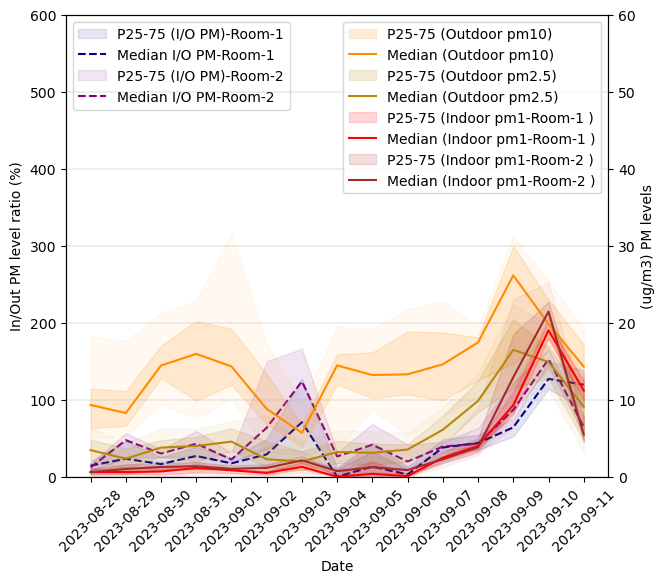

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4658: RuntimeWarning: invalid value encountered in subtract
  subtract(b, diff_b_a * (1 - t), out=lerp_interpolation, where=t >= 0.5,
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a =

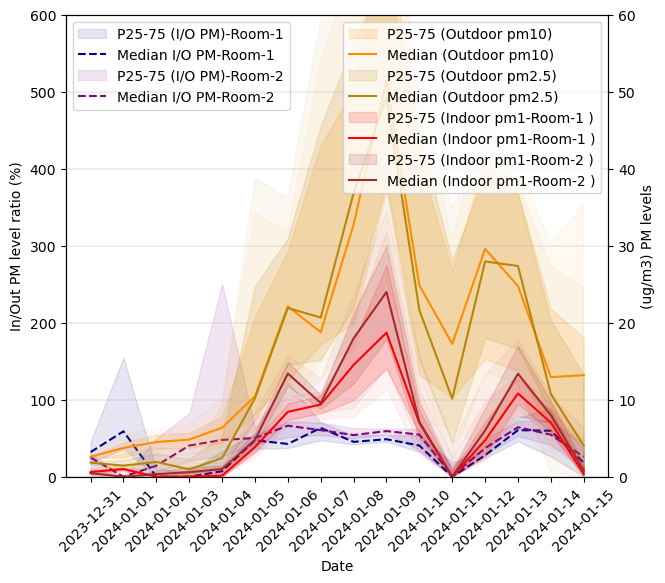

In [ ]:
plot_timeseries_sahara_sept2(data_input1, data_input2 ,pm1_name ,pm25_name ,
                             '2023-08-28', '2023-09-11', 0,600,60, 7, 6)
plot_timeseries_sahara_sept2(data_input1, data_input2 ,pm1_name ,pm25_name ,
                             '2023-12-31', '2024-01-15', 0,600,60, 7, 6)

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\numpy\lib\function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
c:\Users\azimilga\AppData\Loca

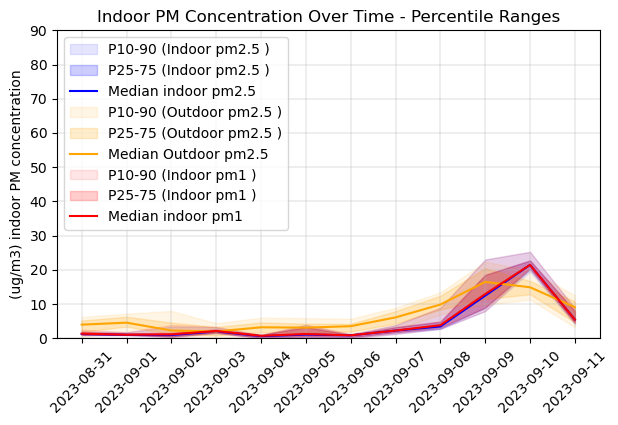

C:\Users\azimilga\AppData\Local\Temp\ipykernel_21352\830389120.py:110: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(rotation=45, labels=daily_stats_pm1_a['date'])
C:\Users\azimilga\AppData\Local\Temp\ipykernel_21352\830389120.py:144: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax2.set_xticklabels(rotation=45, labels=daily_stats_pm1_a['date'])


<Figure size 640x480 with 0 Axes>

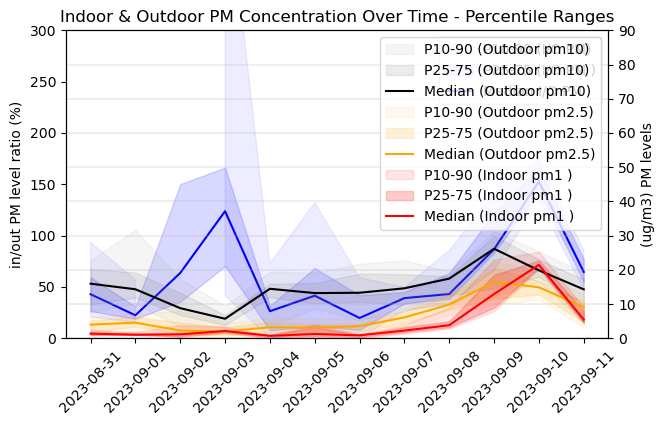

In [ ]:
plot_timeseries_sahara_sept(data_input, pm1_name ,pm25_name ,'2023-08-31', '2023-09-11', 0,90,300, 7, 7)

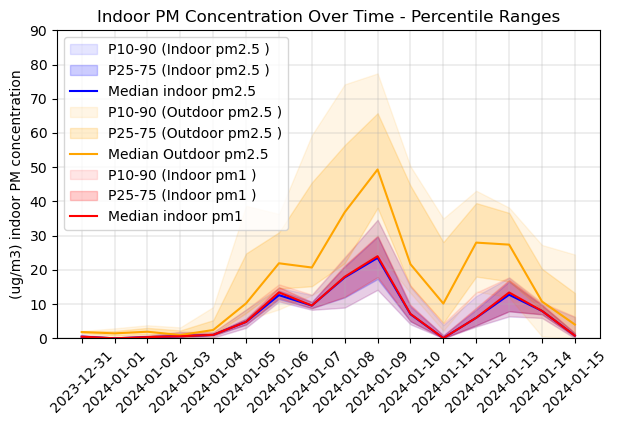

<Figure size 640x480 with 0 Axes>

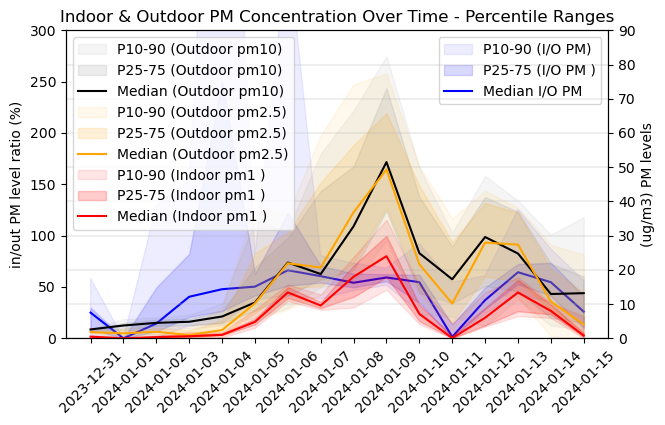

In [ ]:
plot_timeseries_sahara_sept(data_input, pm1_name ,pm25_name ,'2023-12-31', '2024-01-15', 0,90,300, 7, 7)

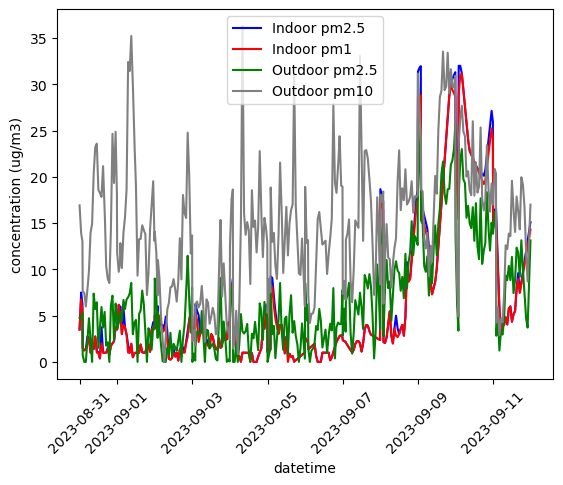

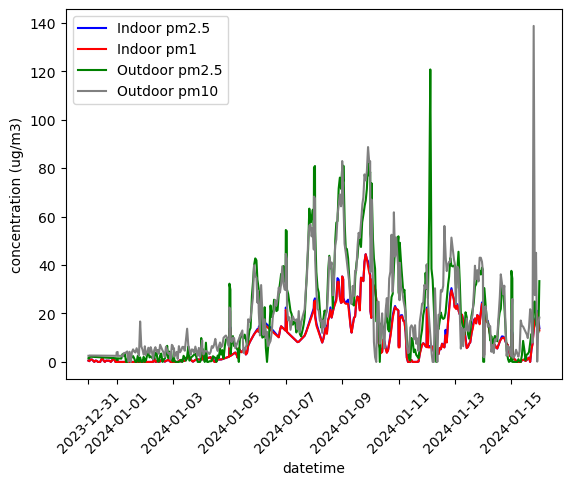

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_timeseries_allPM(data_input[data_input['room_id']==classroom_data], '2023-08-31', '2023-09-11')
plot_timeseries_allPM(data_input[data_input['room_id']==classroom_data], '2023-12-31', '2024-01-15')

# Hourly Analysis

In [32]:
# Create 'season' column
# Convert 'datetime' column to datetime object
data_input_1H['datetime'] = pd.to_datetime(data_input_1H['datetime'])
data_input_1H['heating-season'] = data_input_1H['datetime'].dt.month.apply(lambda x: 'yes' if 5 <= x <= 9 else 'no')
data_input_1H['dust_period'] = data_input_1H['dust_period'].replace({1:'yes', 0:'no'})
data_input = data_input_1H[(data_input_1H['hour'].between(6,18)) 
                                  # &(data_input_1H['room_id']==classroom_data) &
                                  # (data_input_1H['date'].between('2023-09-06', '2023-09-12')
                                 &(data_input_1H['day'].between(0,4))
                                 ]

data_input_filtered = data_input[data_input['room_id']!=class4]
data_input_class = data_input_filtered[data_input_filtered['room_id']==classroom_data]
data_corr= data_input_class.rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)

variable_sequence= out_pm_delay_all+ weather_oslo +airthingsPro_i

data_input_exclude = data_input_filtered[data_input_filtered['dust_period']=='no']
data_input_include = data_input_filtered[data_input_filtered['dust_period']=='yes']
dropped_colums = [ 'dust_period'  , 'room_id'] #+ in_pm_delay_all


c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\dtypes\cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promo

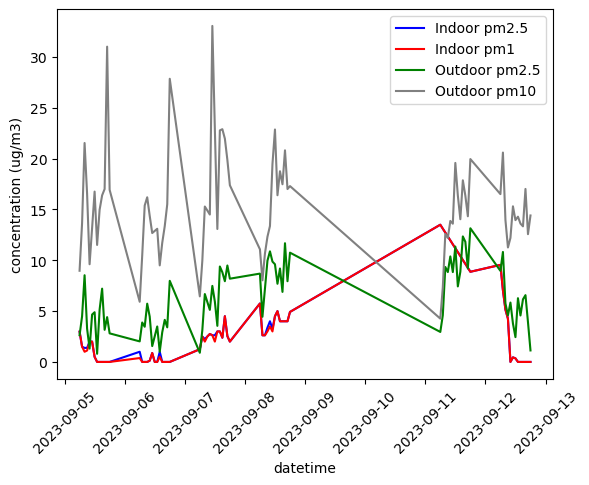

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promo

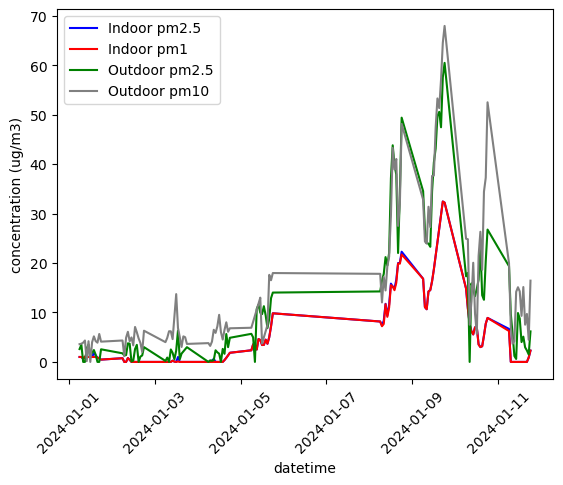

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_timeseries_allPM(data_input_class, '2023-09-05', '2023-09-12')
plot_timeseries_allPM(data_input_class, '2023-12-31', '2024-01-11')

In [ ]:
data_corr[variable_sequence].corr().iloc[-2:]   #[data_corr['dust_period']=='no']

,pm10_o_1,pm2.5_o_1,pm10_o_2,pm2.5_o_2,pm10_o_3,pm2.5_o_3,pm2.5_o,pm10_o,temp_o,rh_o,...,temp_i,rh_i,press_i,enth_i,hura_i,voc_i,bright_i,sound_i,pm1_i,pm2.5_i
pm1_i,0.099890,0.697982,0.085962,0.659318,0.076119,0.604693,0.727782,0.117955,-0.116285,0.166374,...,0.019054,0.056333,0.156677,0.062319,0.055997,0.079511,-0.058256,0.022741,1.000000,0.998952
pm2.5_i,0.100494,0.697453,0.086170,0.658315,0.076280,0.603423,0.727122,0.118513,-0.116354,0.165364,...,0.022152,0.055015,0.157573,0.062110,0.055192,0.084074,-0.054723,0.027126,0.998952,1.000000


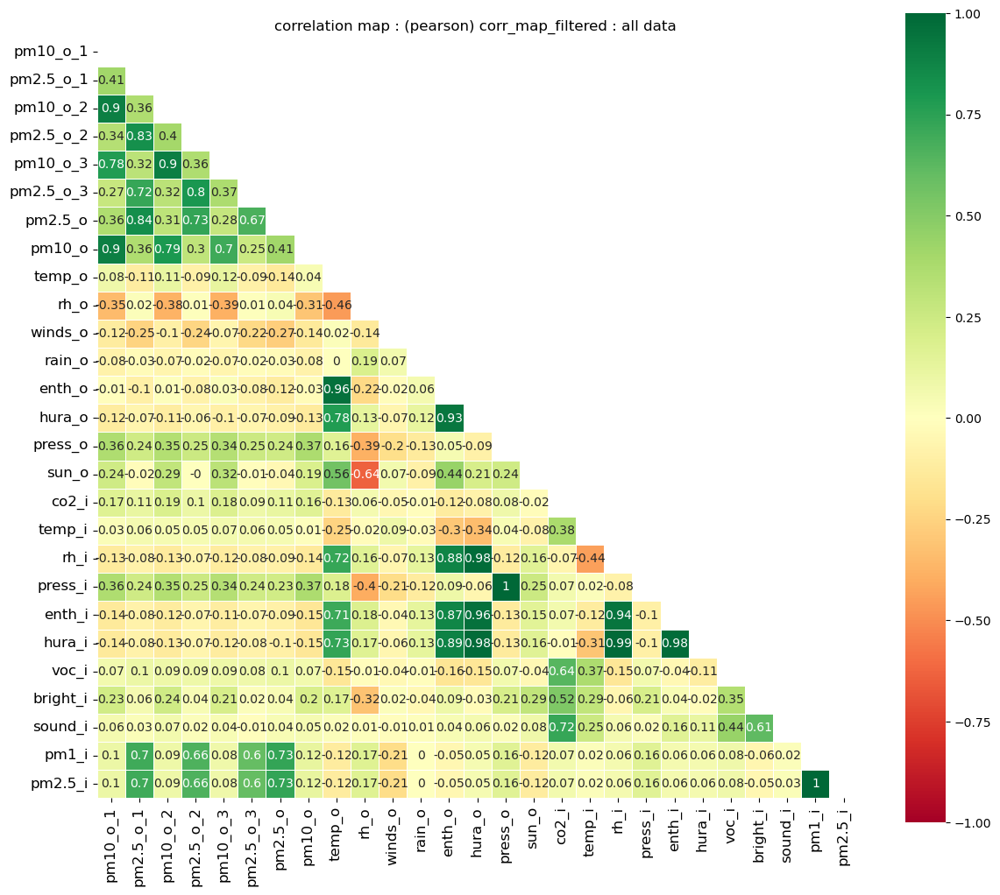

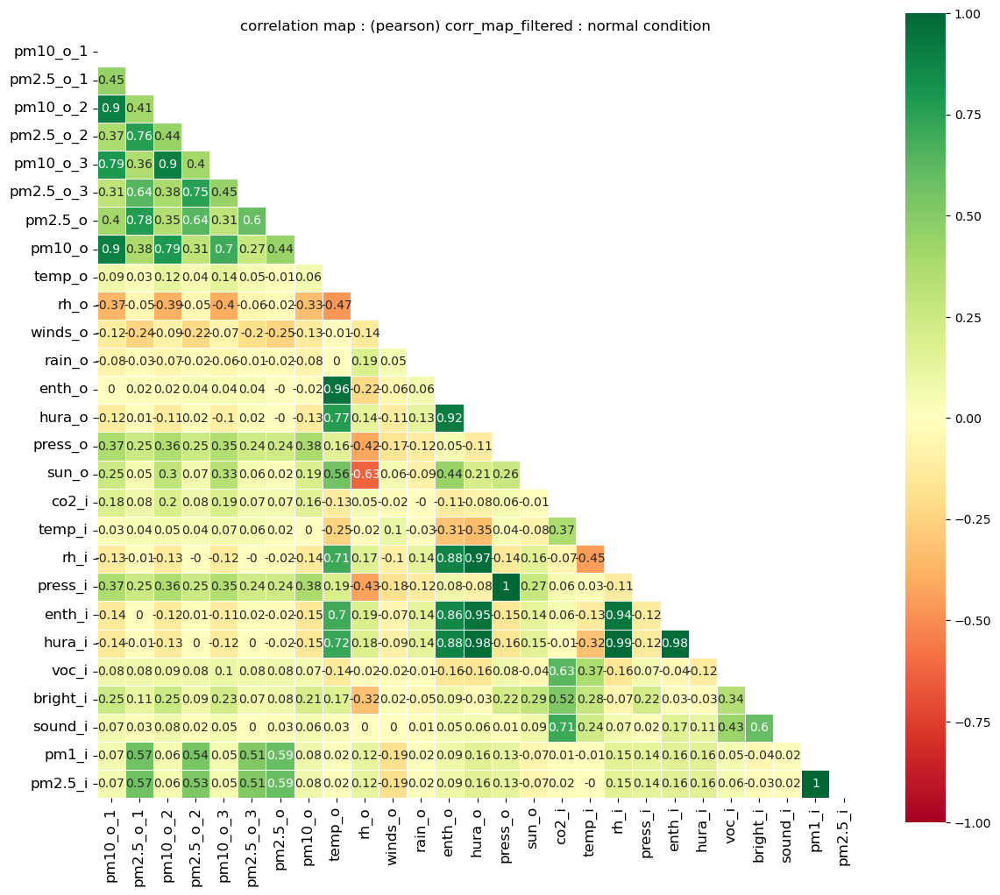

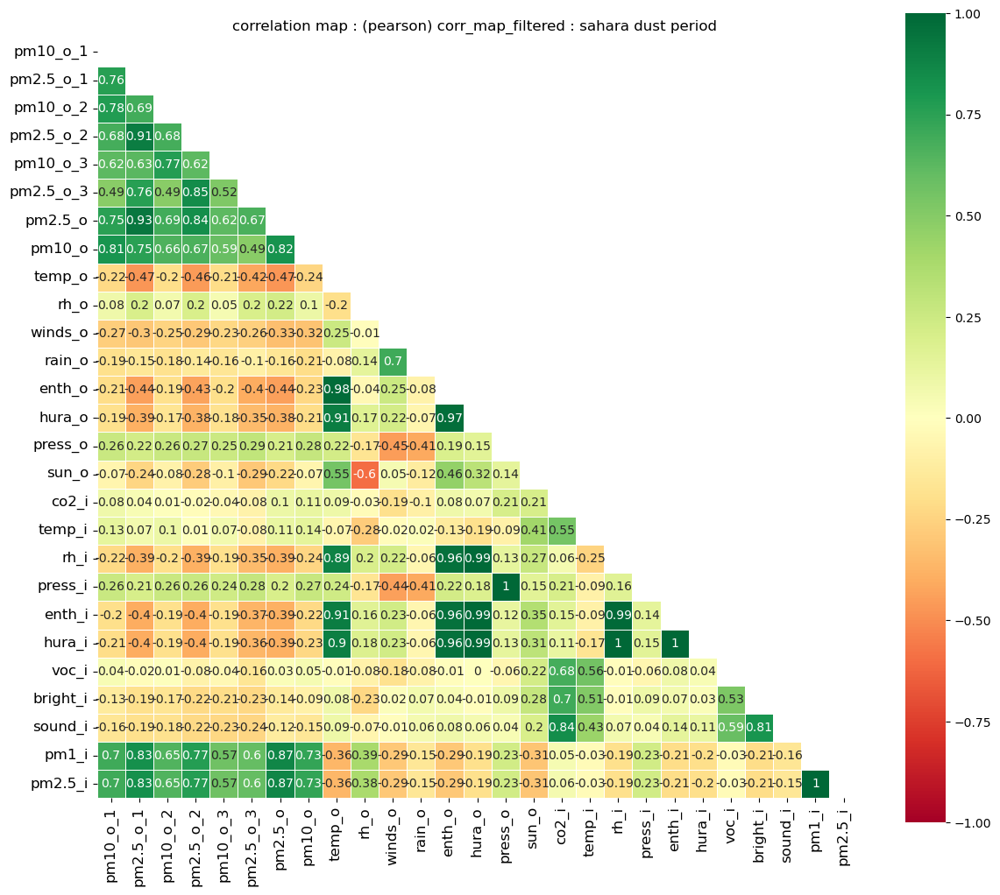

In [ ]:
heatmap_corrvalue(data_corr[variable_sequence]#.drop(dropped_colums , axis=1)
                  ,'pearson', (14,12), 'corr_map_filtered : all data '#+ str(classroom_data)
                  , 12)

heatmap_corrvalue(data_corr[data_corr['dust_period']=='no'][variable_sequence]#.drop(dropped_colums , axis=1)
                  ,'pearson', (14,12), 'corr_map_filtered : normal condition '#+ str(classroom_data)
                  , 12)

heatmap_corrvalue(data_corr[data_corr['dust_period']=='yes'][variable_sequence]#.drop(dropped_colums , axis=1)
                  ,'pearson', (14,12), 'corr_map_filtered : sahara dust period '#+ str(classroom_data)
                  , 12)

In [ ]:
data_between_class = data_input_filtered.copy()
# data_between_class = data_input_filtered[(data_input_filtered['hour'].between(6,17))&(data_input_filtered['day'].between(0,4)) ]
# plt.scatter(data_between_class[data_between_class['room_id']==class2][pm1_name],data_between_class[data_between_class['room_id']==class7][pm1_name])
data_pm25_room1 = data_between_class[data_between_class['room_id']==class2][[pm25_name,'dust_period','hour','day','date']].rename(columns={'pm2.5_a':'room_1'}).reset_index(drop=True)
data_pm25_room2 = data_between_class[data_between_class['room_id']==class7][[pm25_name,'dust_period','hour','day','date']] .rename(columns={'pm2.5_a':'room_2'}).reset_index(drop=True)

data_pm25_room1and2 = data_pm25_room1.join(data_pm25_room2[['room_2']], how='outer')
data_pm25_room1and2['dust_period'] = data_pm25_room1and2['dust_period'].replace({1:'yes', 0:'no'})

data_pm1_room1 = data_between_class[data_between_class['room_id']==class2][[pm1_name,'dust_period','hour','day','date']].rename(columns={'pm1_a':'room_1'}).reset_index(drop=True)
data_pm1_room2 = data_between_class[data_between_class['room_id']==class7][[pm1_name,'dust_period','hour','day','date']] .rename(columns={'pm1_a':'room_2'}).reset_index(drop=True)

data_pm1_room1and2 = data_pm1_room1.join(data_pm1_room2[['room_2']], how='outer')
data_pm1_room1and2['dust_period'] = data_pm1_room1and2['dust_period'].replace({1:'yes', 0:'no'})


In [ ]:

with pd.ExcelWriter(ML_directory+ 'compare two room.xlsx') as writer: # make one file with severel sheet

    # use to_excel function and specify the sheet_name and index to store the dataframe in specified sheet
    data_pm1_room1and2.to_excel(writer, sheet_name = 'PM1.0', index=True) 
    data_pm25_room1and2.to_excel(writer, sheet_name = 'PM2.5', index=True) 

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


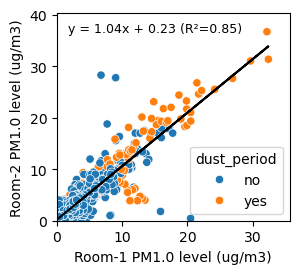

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


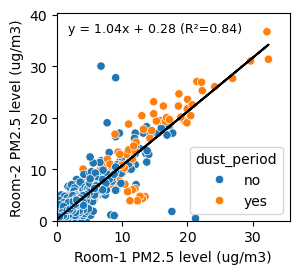

In [ ]:
plot_scatter_graph_single_regress (data_pm1_room1and2,'room_1', 'room_2', 'dust_period', 3.0, 2.7 , 9,
                                   'Room-1 PM1.0 level (ug/m3)','Room-2 PM1.0 level (ug/m3)', True)  
plot_scatter_graph_single_regress (data_pm25_room1and2,'room_1', 'room_2', 'dust_period', 3.0, 2.7 , 9,
                                   'Room-1 PM2.5 level (ug/m3)','Room-2 PM2.5 level (ug/m3)', True)  

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


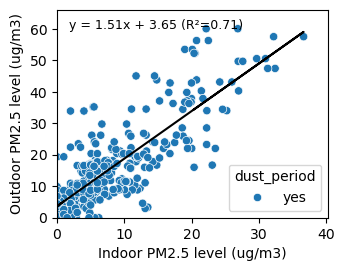

In [ ]:
plot_scatter_graph_single_regress (data_input_include,'pm2.5_a', 'pm2.5_o_1', 'dust_period', 3.5, 2.7 , 9,
                                   'Indoor PM2.5 level (ug/m3)','Outdoor PM2.5 level (ug/m3)', True)  

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


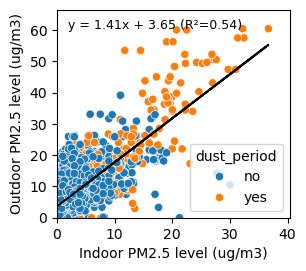

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


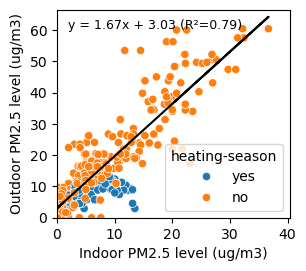

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


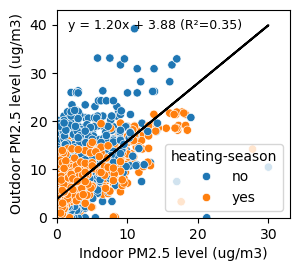

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


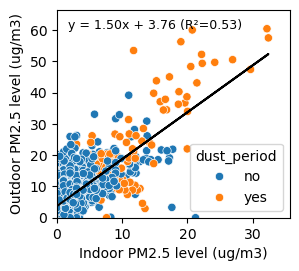

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


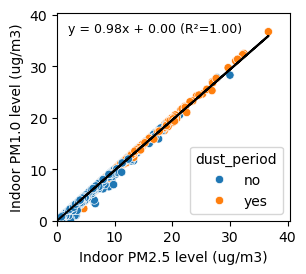

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


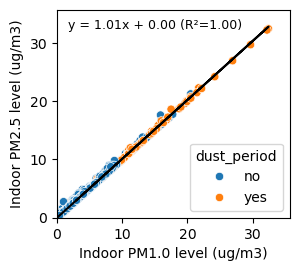

In [ ]:
plot_scatter_graph_single_regress (data_input_filtered,'pm2.5_a', 'pm2.5_o', 'dust_period', 3.0, 2.7 , 9,
                                   'Indoor PM2.5 level (ug/m3)','Outdoor PM2.5 level (ug/m3)', True)  
plot_scatter_graph_single_regress (data_input_include,'pm2.5_a', 'pm2.5_o', 'heating-season', 3.0, 2.7, 9,
                                   'Indoor PM2.5 level (ug/m3)','Outdoor PM2.5 level (ug/m3)', True)  
plot_scatter_graph_single_regress (data_input_exclude,'pm2.5_a', 'pm2.5_o', 'heating-season', 3.0, 2.7, 9,
                                   'Indoor PM2.5 level (ug/m3)','Outdoor PM2.5 level (ug/m3)', True)  

plot_scatter_graph_single_regress (data_input_class,'pm2.5_a', 'pm2.5_o', 'dust_period', 3.0, 2.7 , 9,
                                   'Indoor PM2.5 level (ug/m3)','Outdoor PM2.5 level (ug/m3)', True) 
plot_scatter_graph_single_regress (data_input_filtered,'pm2.5_a', 'pm1_a', 'dust_period', 3.0, 2.7 , 9,
                                   'Indoor PM2.5 level (ug/m3)','Indoor PM1.0 level (ug/m3)', False)  
plot_scatter_graph_single_regress (data_input_class,'pm1_a','pm2.5_a',  'dust_period', 3.0, 2.7 , 9,
                                   'Indoor PM1.0 level (ug/m3)','Indoor PM2.5 level (ug/m3)', False)  


In [ ]:
data_input_filtered[data_input_filtered['room_id']==classroom_data][pm25_out_name].max()

60.46

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])


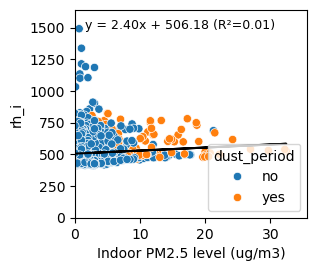

In [ ]:
plot_scatter_graph_single_regress (data_input_filtered[data_input_filtered['room_id']==classroom_data],
                                    'pm2.5_a', 'co2_a','dust_period', 3.0, 2.7 , 9,
                                   'Indoor PM2.5 level (ug/m3)', 'rh_i',True)  

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


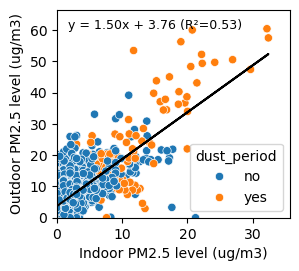

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


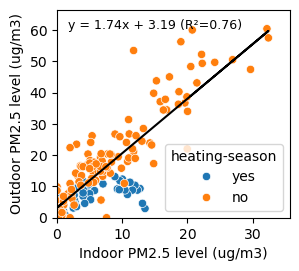

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


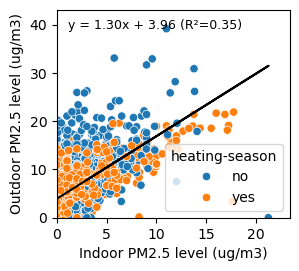

In [ ]:
plot_scatter_graph_single_regress (data_input_filtered[data_input_filtered['room_id']==classroom_data],
                                   'pm2.5_a', 'pm2.5_o', 'dust_period', 3.0, 2.7 , 9,
                                   'Indoor PM2.5 level (ug/m3)','Outdoor PM2.5 level (ug/m3)', True)  
plot_scatter_graph_single_regress (data_input_include[data_input_include['room_id']==classroom_data],'pm2.5_a', 'pm2.5_o', 'heating-season', 3.0, 2.7, 9,
                                   'Indoor PM2.5 level (ug/m3)','Outdoor PM2.5 level (ug/m3)', True)  
plot_scatter_graph_single_regress (data_input_exclude[data_input_exclude['room_id']==classroom_data],'pm2.5_a', 'pm2.5_o', 'heating-season', 3.0, 2.7, 9,
                                   'Indoor PM2.5 level (ug/m3)','Outdoor PM2.5 level (ug/m3)', True)  

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


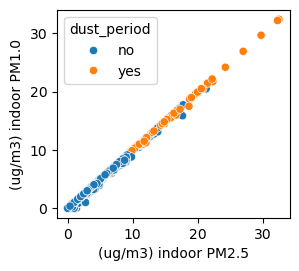

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


<Figure size 640x480 with 0 Axes>

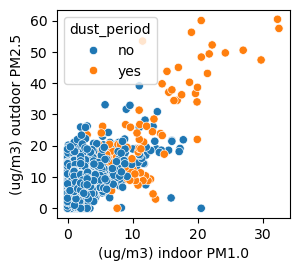

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


<Figure size 640x480 with 0 Axes>

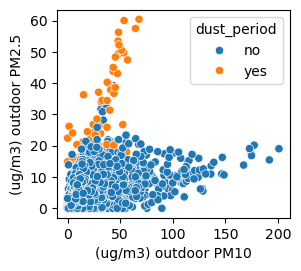

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


<Figure size 640x480 with 0 Axes>

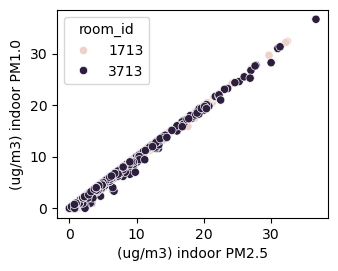

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


<Figure size 640x480 with 0 Axes>

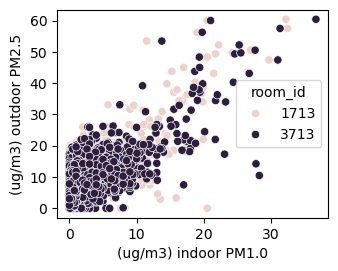

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


<Figure size 640x480 with 0 Axes>

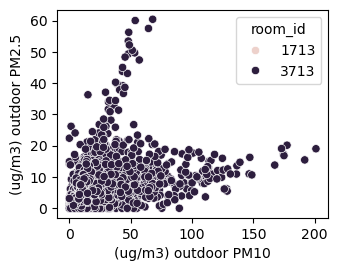

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


<Figure size 640x480 with 0 Axes>

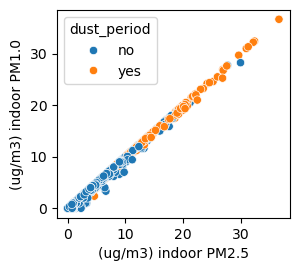

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


<Figure size 640x480 with 0 Axes>

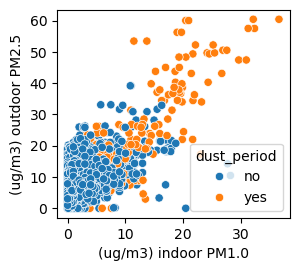

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])


<Figure size 640x480 with 0 Axes>

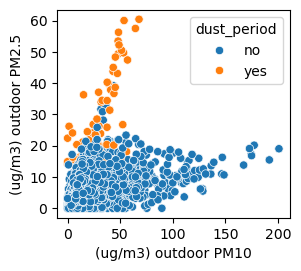

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_scatter_graph (data_input_class, (3.0,2.7),'dust_period')
plot_scatter_graph (data_input_filtered, (3.5,2.7),'room_id')
plot_scatter_graph (data_input_filtered, (3.0,2.7),'dust_period')

In [ ]:
data_input_class.columns

Index(['datetime', 'press_a', 'temp_a', 'rh_a', 'co2_a', 'voc_a', 'sound_a',
       'bright_a', 'pm1_a', 'pm2.5_a', 'enth_a', 'hura_a', 'temp_o', 'rh_o',
       'winds_o', 'press_o', 'sun_o', 'pm2.5_o', 'pm10_o', 'nox_o', 'no2_o',
       'no_o', 'rain_o', 'enth_o', 'hura_o', 'day', 'hour', 'room_id',
       'school_id', 'temp_o_1', 'temp_o_2', 'temp_o_3', 'rh_o_1', 'rh_o_2',
       'rh_o_3', 'winds_o_1', 'winds_o_2', 'winds_o_3', 'rain_o_1', 'rain_o_2',
       'rain_o_3', 'enth_o_1', 'enth_o_2', 'enth_o_3', 'hura_o_1', 'hura_o_2',
       'hura_o_3', 'press_o_1', 'press_o_2', 'press_o_3', 'sun_o_1', 'sun_o_2',
       'sun_o_3', 'pm2.5_o_1', 'pm2.5_o_2', 'pm2.5_o_3', 'pm10_o_1',
       'pm10_o_2', 'pm10_o_3', 'nox_o_1', 'nox_o_2', 'nox_o_3', 'no2_o_1',
       'no2_o_2', 'no2_o_3', 'no_o_1', 'no_o_2', 'no_o_3', 'pm1_a_1',
       'pm1_a_2', 'pm1_a_3', 'pm2.5_a_1', 'pm2.5_a_2', 'pm2.5_a_3', 'date',
       'time', 'dust_period', 'i/o pm', 'heating-season'],
      dtype='object')

In [ ]:
to_pairplot = ['dust_period','pm2.5_o', 'pm10_o','rh_i', 'co2_i','pm1_i', 'pm2.5_i']

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promo

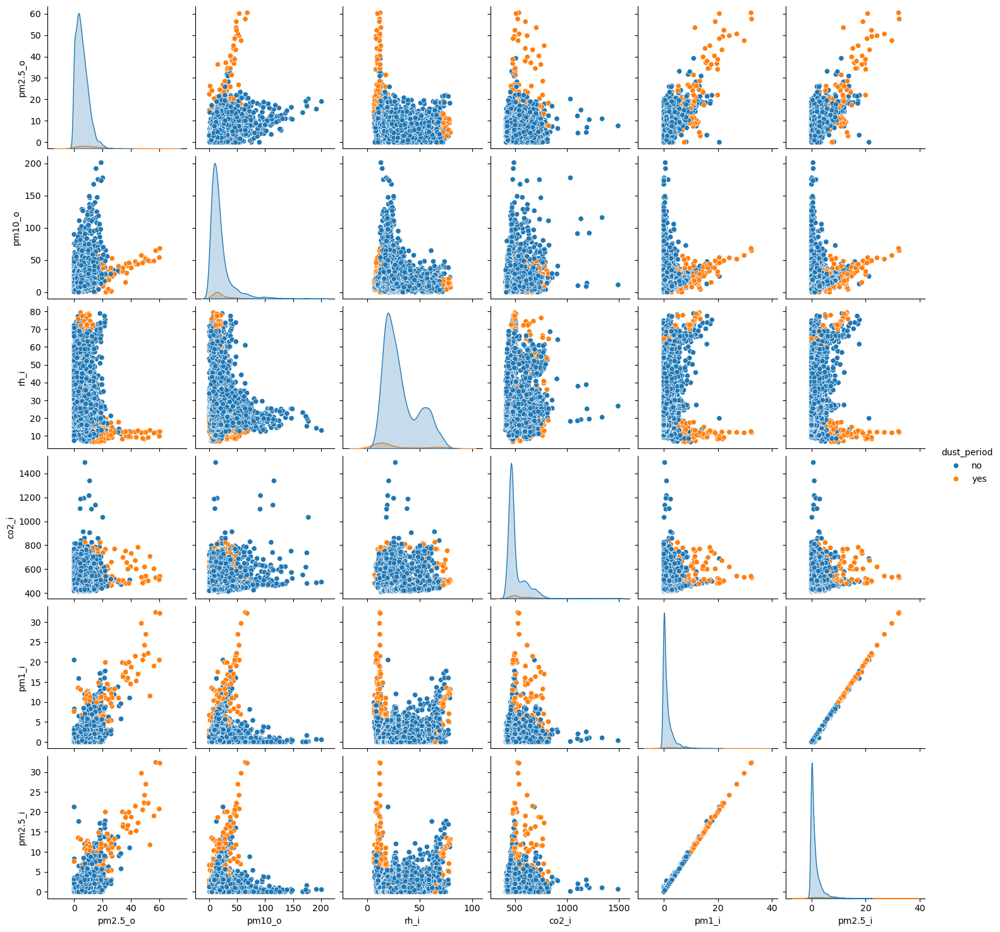

In [ ]:
sns.pairplot(data_corr[to_pairplot], kind= 'scatter', hue='dust_period')

In [ ]:
sns.pairplot(data_corr[variable_sequence+['dust_period']], kind= 'scatter', hue='dust_period')

KeyboardInterrupt: 

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promo

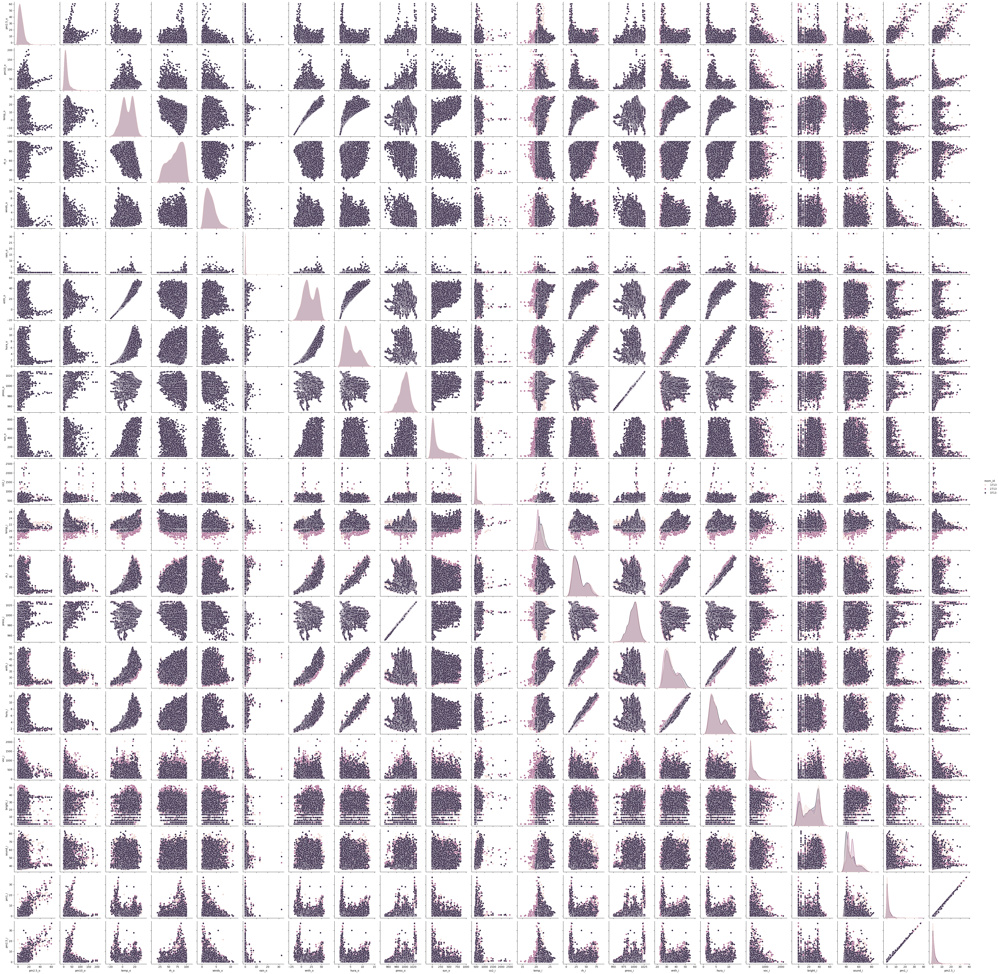

In [ ]:
sns.pairplot(data_corr[variable_sequence+['room_id']], kind= 'scatter', hue='room_id')

C:\Users\azimilga\AppData\Local\Temp\ipykernel_21352\692380670.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_input_graph['dust_period'].replace({1:'yes', 0:'no'}, inplace=True)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\dtypes\cast.py:1841: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
C:\Users\azimilga\AppData\Local\Temp\ipykernel_21352\692380670.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user

<Figure size 300x300 with 0 Axes>

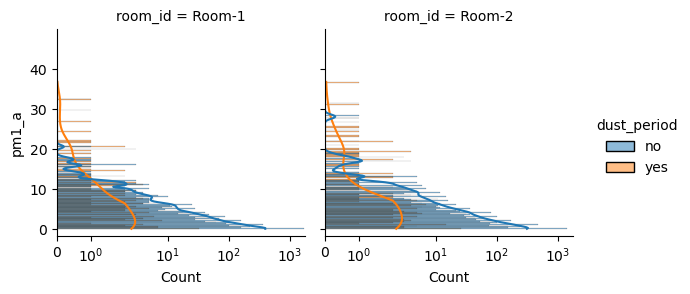

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_hist_graph (data_input_filtered, pm1_name, 'room_id', (3,3),  pm1_a_label, 'linear' ,  'symlog' )

C:\Users\azimilga\AppData\Local\Temp\ipykernel_21352\3287222525.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['dust_period'].replace({1:'yes', 0:'no'}, inplace=True)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps.dtype], [])
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\pandas\core\algorithms.py:516: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/

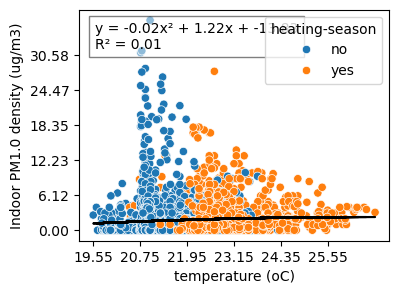

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_scatter_thermalcomfort (data_input_class, pm1_name, pm1_a_label, temp_data_name, 'temperature (oC)', 'heating-season' )


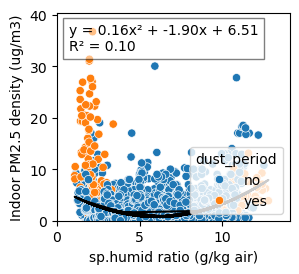

<Figure size 640x480 with 0 Axes>

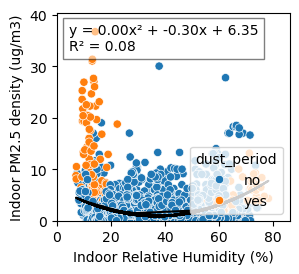

<Figure size 640x480 with 0 Axes>

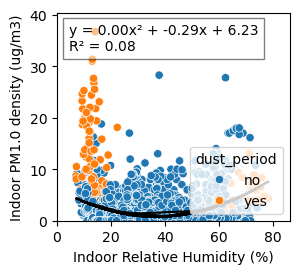

<Figure size 640x480 with 0 Axes>

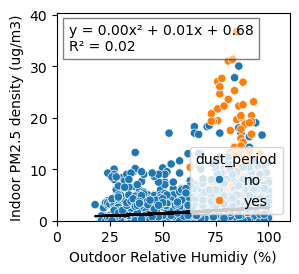

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_scatter_thermalcomfort (data_input_class, pm25_name, pm25_a_label, humid_ratio_name, 'sp.humid ratio (g/kg air)',  'dust_period', (3.0,2.7) ) #(0,15), (0,60) ,
plot_scatter_thermalcomfort (data_input_class, pm25_name, pm25_a_label, rel_hum_name, rh_a_label,  'dust_period' , (3.0,2.7) ) #(0,120), (0,60) ,
plot_scatter_thermalcomfort (data_input_class, pm1_name, pm1_a_label, rel_hum_name, rh_a_label,  'dust_period' , (3.0,2.7) ) #(0,120), (0,60) ,
plot_scatter_thermalcomfort (data_input_class, pm25_name, pm25_a_label, rel_hum_out_name, rh_o_label,  'dust_period' , (3.0,2.7) )

In [ ]:
plot_scatter_thermalcomfort (data_input_class, pm1_name, pm1_a_label, voc_name, voc_a_label, (10,3000), (0,60),'dust_period'  )
plot_scatter_thermalcomfort (data_input_class, pm1_name, pm1_a_label, 'winds_o', winds_o_label, (0,data_input_filtered['winds_o'].max()), (0,60) ,'dust_period' )
plot_scatter_thermalcomfort (data_input_class, pm1_name, pm1_a_label, sun_out_name, sun_o_label, (0,data_input_filtered[sun_out_name].max()), (0,60) ,'dust_period' )
plot_scatter_thermalcomfort (data_input_class, pm1_name, pm1_a_label, temp_data_name, temp_a_label, (18,27), (0,60) ,'dust_period' )
plot_scatter_thermalcomfort (data_input_class, pm1_name, pm1_a_label, rel_hum_name, rh_a_label, (10,100), (0,60),'dust_period'  )


TypeError: plot_scatter_thermalcomfort() takes 6 positional arguments but 8 were given

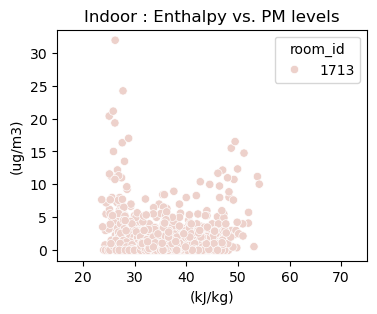

<Figure size 640x480 with 0 Axes>

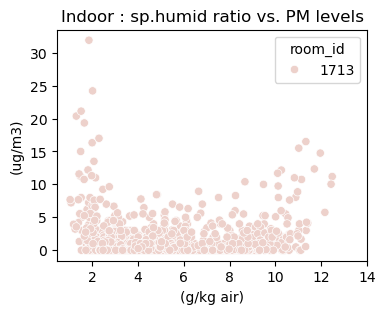

<Figure size 640x480 with 0 Axes>

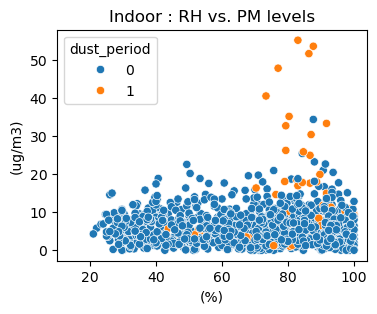

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_scatter_graph_single(data_input_filtered,  enthalpy_name, pm1_name, 'room_id', 
                          (4,3), 'Indoor : Enthalpy vs. PM levels', '(kJ/kg)', '(ug/m3)' , 'linear', np.arange(15, 80, step=10))
plot_scatter_graph_single(data_input_filtered, humid_ratio_name, pm1_name, 'room_id', 
                          (4,3), 'Indoor : sp.humid ratio vs. PM levels' , '(g/kg air)', '(ug/m3)', 'linear', np.arange(1,15, step=1))
plot_scatter_graph_single(data_input_filtered, rel_hum_out_name, pm25_out_name, 'dust_period', 
                          (4,3), 'Indoor : RH vs. PM levels' , '(%)' , '(ug/m3)', 'linear', np.arange(10, 110, step=10) )

# Tri-hourly Analysis

In [ ]:

data_input = data_input_3H[(data_input_3H['hour'].between(6,18)) 
                                  &(data_input_1H['room_id']!=class4)# &
                                  # (data_input_3H['date'].between('2023-11-06', '2024-03-31'))
                                  # (data_input_3H['date'].between('2023-04-30', '2023-10-06'))
                                  # (data_input_3H['date'].between('2023-11-31', '2024-03-31'))
                                 & (data_input_3H['day'].between(0,4))
                                 ]

data_input_filtered = data_input[data_input['room_id']==classroom_data]

data_input_exclude = data_input_filtered[data_input_filtered['dust_period']==0]
data_input_include = data_input_filtered[data_input_filtered['dust_period']==1]
dropped_colums = [ 'dust_period'  , 'room_id'] #+ in_pm_delay_all

In [ ]:
from sklearn.metrics import r2_score
plt.figure(figsize=(4,3))
sns.scatterplot(data_input_filtered, y=pm1_name, x=rel_hum_name)
    # plt.xscale('log')
    # plt.yscale('log')
p = np.polyfit(data_input_filtered[rel_hum_name], data_input_filtered[pm1_name], 2)
y_fit = np.polyval(p, data_input_filtered[rel_hum_name])
r2 = r2_score(data_input_filtered[pm1_name], y_fit)

equation = f'y = {p[0]:.4f}x² + {p[1]:.2f}x + {p[2]:.2f}'#\nR² = {r2:.2f}'
plt.plot(data_input_filtered[rel_hum_name], y_fit, color='black', label=f'Trend Line: {equation}')

plt.text(0.05, 0.95, equation, fontsize=10, transform=plt.gca().transAxes,
         verticalalignment='top', bbox=dict(facecolor='white', alpha=0.5))

plt.xlabel(rel_hum_name #+' ' +x
               )
plt.ylabel(pm1_name #+' '+y
               )
plt.xticks(np.arange(10, 100, step=10))
# plt.xscale('symlog')
plt.show()
plt.clf()

In [ ]:
plot_scatter_graph_single(data_input_exclude,  enthalpy_name, pm25_name, 'room_id', 
                          (4,3), 'Indoor : Enthalpy vs. PM levels', '(kJ/kg)', '(ug/m3)' , 'log', np.arange(15, 60, step=0.1))
plot_scatter_graph_single(data_input_exclude, humid_ratio_name, pm25_name, 'room_id', 
                          (4,3), 'Indoor : sp.humid ratio vs. PM levels' , '(g/kg air)', '(ug/m3)', 'log', np.arange(10, 100, step=0.1))
plot_scatter_graph_single(data_input_exclude, rel_hum_name, pm25_name, 'room_id', 
                          (4,3), 'Indoor : RH vs. PM levels' , '(%)' , '(ug/m3)', 'log', np.arange(10, 90) )

In [ ]:
rain_data_1D = pd.pivot_table( data_input_1H [data_input_1H['room_id']==classroom_data ], values=['rain_o'], index='date', aggfunc='sum')
check_rain = data_input_1D [data_input_1D['room_id']==classroom_data].drop('rain_o',axis=1) .join(rain_data_1D.reset_index(drop=True) )
check_rain['i/o pm'] = check_rain['pm1_a']/check_rain['pm2.5_o']


Text(0.5, 1.0, 'daily outdoor data : Rain (mm) vs. PM2.5 (ug/m3)')

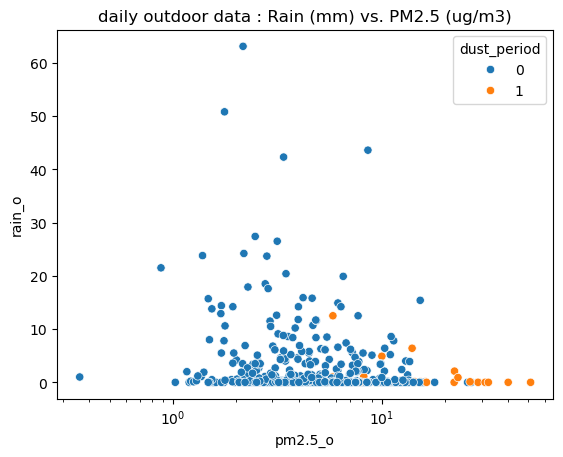

In [ ]:
sns.scatterplot(data=check_rain , x='pm2.5_o', y='rain_o', hue='dust_period')
plt.xscale('log')
plt.title('daily outdoor data : Rain (mm) vs. PM2.5 (ug/m3)')

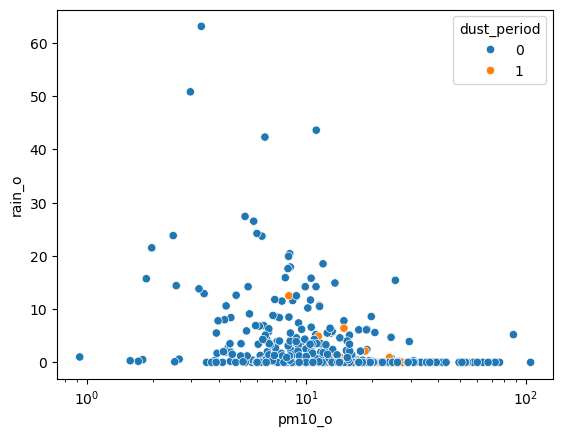

In [ ]:
sns.scatterplot(data=check_rain , x='pm10_o', y='rain_o', hue='dust_period')
plt.xscale('log')

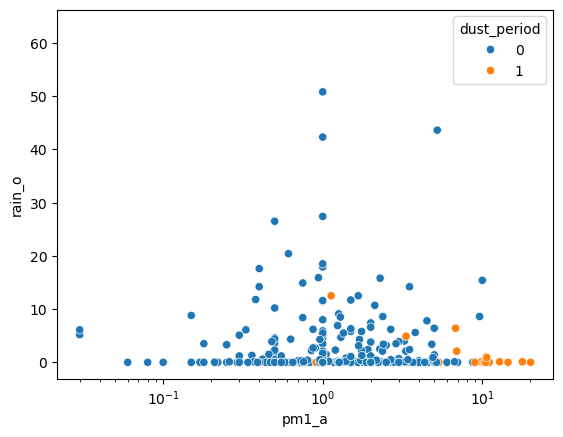

In [ ]:
sns.scatterplot(data=check_rain , x='pm1_a', y='rain_o', hue='dust_period')
plt.xscale('log')

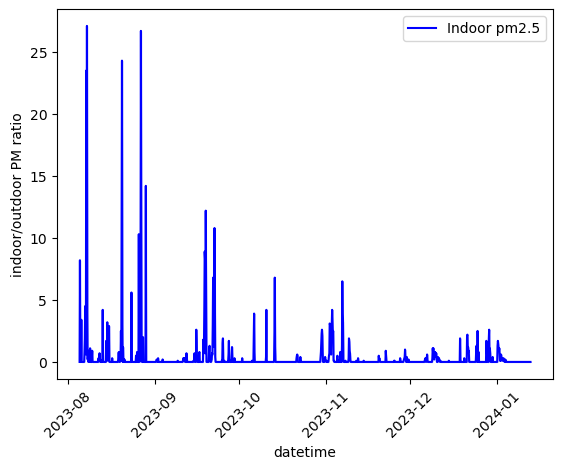

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_timeseries_single(data_input_3H, '2023-08-05', '2024-01-12', 'rain_o', 'indoor/outdoor PM ratio'  )

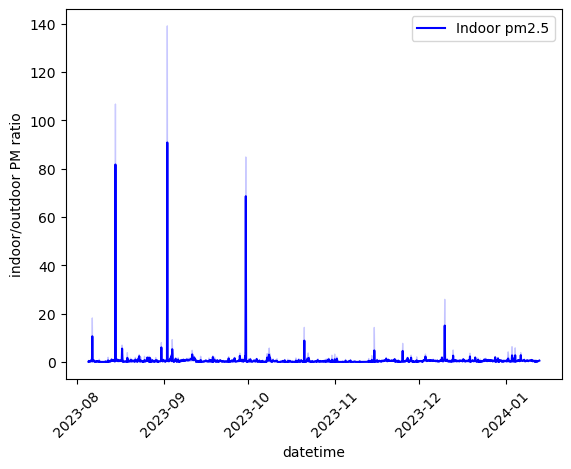

<Figure size 640x480 with 0 Axes>

In [ ]:
plot_timeseries_single(data_input_3H, '2023-08-05', '2024-01-12', 'i/o pm', 'indoor/outdoor PM ratio'  )

# Machine Learning

## Data Preparation

In [196]:
selected_input_variable= ['pm1_a','pm2.5_a','temp_a','rh_a','press_a','enth_a','hura_a','co2_a','voc_a',
                          'pm2.5_o','pm10_o','temp_o','rh_o','rain_o','enth_o','hura_o','press_o',
                          ] + out_pm25_delay_all 

# simplified_variable = [ rel_hum_name, temp_out_name, co2_name,  humid_ratio_name ]
simplified_variable = [co2_name,  rel_hum_name, humid_ratio_name , temp_out_name, humid_ratio_out_name, enthalpy_out_name] #

# simplified_variable = [co2_name, rel_hum_name, temp_out_name, rel_hum_out_name]

In [818]:
simplified_variable

['co2_a', 'rh_a', 'hura_a', 'temp_o', 'hura_o', 'enth_o']

In [ ]:
# ALL INPUTS
target_col = 'pm2.5_a'
scene_train = '_all'
data_ML_time_step = '1H'
data_input = data_input_1H.copy()
# selected_input_variable = airthingsPro +weather_oslo + out_pm25_delay_all + out_pm10_delay_all
data_ML = data_input[data_input['room_id']==classroom_data][selected_input_variable].drop('pm1_a',axis=1).sort_values(target_col).copy()
xb = data_ML.copy().drop(target_col, axis=1).rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)
y = data_ML[[target_col]].rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)
print(classroom_data)

In [258]:
# SIMPLIFIED + delay
target_col = 'pm2.5_a'
scene_train = '_simplified'
data_ML_time_step = '1H'
data_input = data_input_1H.copy()
selected_input_variable = [pm25_out_name] +  out_pm25_delay_all + [target_col]  + simplified_variable
data_ML = data_input[data_input['room_id']==classroom_data][selected_input_variable].sort_values(target_col).copy()
xb = data_ML.copy().drop(target_col, axis=1).rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)
y = data_ML[[target_col]].rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)
print(classroom_data)

3713


In [300]:
# Simplified NO DELAY
target_col = 'pm2.5_a'
scene_train = '_Nodelay'
data_ML_time_step = '1H'
data_input = data_input_1H.copy()

selected_input_variable = [pm25_out_name] + [target_col]  + simplified_variable
data_ML = data_input[data_input['room_id']==classroom_data][selected_input_variable].sort_values(target_col).copy()
xb = data_ML.copy().drop(target_col, axis=1).rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)
y = data_ML[[target_col]].rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)
print(classroom_data)

3713


In [309]:
#OUTDOOR DATA ONLY
target_col = 'pm2.5_a'
scene_train = '_simplified v2'
data_ML_time_step = '1H'
data_input = data_input_1H.copy()
selected_input_variable = out_pm25_delay_all + [target_col,pm25_out_name]
data_ML = data_input[data_input['room_id']==classroom_data][selected_input_variable].sort_values(target_col).copy()

xb = data_ML.copy().drop(target_col, axis=1).rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)
y = data_ML[[target_col]].rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)
print(classroom_data)

3713


In [597]:
print(data_ML.columns)
print(xb.columns)

Index(['pm1_a', 'temp_a', 'rh_a', 'press_a', 'enth_a', 'hura_a', 'co2_a',
       'voc_a', 'pm2.5_o', 'pm10_o', 'temp_o', 'rh_o', 'rain_o', 'enth_o',
       'hura_o', 'press_o', 'pm2.5_o_1', 'pm2.5_o_2', 'pm2.5_o_3'],
      dtype='object')
Index(['temp_i', 'rh_i', 'press_i', 'enth_i', 'hura_i', 'co2_i', 'voc_i',
       'pm2.5_o', 'pm10_o', 'temp_o', 'rh_o', 'rain_o', 'enth_o', 'hura_o',
       'press_o', 'pm2.5_o_1', 'pm2.5_o_2', 'pm2.5_o_3'],
      dtype='object')


0.5787416809306052
3713 pm2.5_a


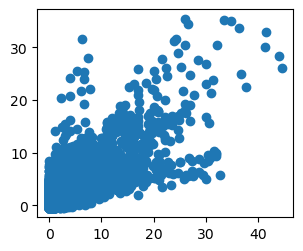

In [310]:
# # Apply delays to all columns
# def apply_delay(data, delay=1):
#     delayed_data = np.roll(data, delay)
#     delayed_data[:delay] = 0
#     return delayed_data

# delays = 3
# for delay in range(1, delays + 1):
#     for col in range(n_features):  # Apply delay to all columns
#         X = np.hstack((X, apply_delay(X[:, col].reshape(-1, 1), delay)))
number_of_columns=xb.shape[1]
# Standardize the features

scaler = MinMaxScaler()
scaler2 = MinMaxScaler()

# data_ML = data_input[data_input['room_id']==classroom_data][selected_input_variable].sort_values(target_col).copy()
# xb = data_ML.copy().drop(target_col, axis=1).rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)
# y = data_ML[[target_col]].rename(columns=lambda x: x[:-2] + '_i' if x.endswith('_a') else x)

X = scaler.fit_transform(xb)

# Split the data
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

X_scaled = scaler2.fit_transform(xb)

pca = PCA(n_components=number_of_columns)
X_pca = pca.fit_transform(X_scaled)


from sklearn.linear_model import LinearRegression

model = LinearRegression()
model.fit(X_pca, y)

y_pred = model.predict(X_pca)
plt.figure(figsize=(3.3,2.7))
plt.scatter(y,y_pred)
print(r2_score(y,y_pred))
print(str(classroom_data) + ' ' + target_col)

In [311]:
folder_ML = 'ML'
directory_path = platform_directory + '/' + folder_project + '/' + folder_ready + '/'+ folder_year + '/' + school_name + '/' + folder_export
folder_model = data_ML_time_step + '_' + school_name + '_'+ folder_year + '_'
ML_directory = directory_path + '/'+ folder_ML + '/' + folder_model + str(target_col) + '_'+class_dir + scene_train  #+scene_what

# todays_date = '_20240719'
print(ML_directory)

C:/Users/azimilga/project/data-ready/all years/kubenVGS/export/ML/1H_kubenVGS_all years_pm2.5_a_3713_simplified v2


In [ ]:
# IMPORT BACK THE MODELS
Lin_reg = joblib.load( ML_directory + '_Lin_reg' + '.joblib')
model_ETR = joblib.load(  ML_directory + '_model_ETR' + '.joblib')
model_DTR = joblib.load(  ML_directory + '_model_DTR' + '.joblib')
model_RFR = joblib.load(  ML_directory + '_model_RFR' + '.joblib')
model_MLPR = joblib.load( ML_directory + '_model_MLPR' + '.joblib')
model_XGBR = joblib.load( ML_directory + '_model_XGBR' + '.joblib')

y_pred_LinReg= Lin_reg.predict(X)
y_pred_DTR= model_DTR.predict(X).reshape(-1,1)
y_pred_RFR= model_RFR.predict(X).reshape(-1,1)
y_pred_ETR= model_ETR.predict(X).reshape(-1,1)
y_pred_XGBR= model_XGBR.predict(X).reshape(-1,1)
y_pred_MLPR = model_MLPR.predict(X)

In [ ]:
# Perform PCA
pca = PCA(n_components=number_of_columns)
principal_components = pca.fit_transform(X_scaled)
X_pca_columns=[f'PC{i}' for i in range(1, number_of_columns + 1)] 

# Create a DataFrame with the principal components
pc_df = pd.DataFrame(data=principal_components, columns=X_pca_columns )

# variance plot
plt.figure(figsize=(4, 3))
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance by Principal Components')
plt.axhline(y=0.8, color='r', linestyle='--')
plt.show()

fig_size=(3.5, 2.7)
# Scree Plot
plt.figure(figsize=fig_size)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)')
plt.title('Explained Variance')
plt.show()

# 2D Scatter Plot
plt.figure(figsize=fig_size)
sns.scatterplot(x='PC1', y='PC2', data=pc_df)
plt.title('PCA - 2 Principal Components')
plt.show()


# # Biplot
# plt.figure(figsize=fig_size)
# plt.scatter(pc_df['PC1'], pc_df['PC2'])
# for i, column in enumerate(xb.columns):
#     plt.arrow(0, 0, pca.components_[0, i], pca.components_[1, i], color='r', alpha=0.5)
#     plt.text(pca.components_[0, i], pca.components_[1, i], column, color='g', ha='center', va='center')
# plt.xlabel('PC1')
# plt.ylabel('PC2')
# plt.title('PCA Biplot')
# plt.grid()
# plt.show()

# # Biplot
# plt.figure(figsize=fig_size)
# plt.scatter(pc_df['PC2'], pc_df['PC3'])
# for i, column in enumerate(xb.columns):
#     plt.arrow(0, 0, pca.components_[0, i], pca.components_[1, i], color='r', alpha=0.5)
#     plt.text(pca.components_[0, i], pca.components_[1, i], column, color='g', ha='center', va='center')
# plt.xlabel('PC2')
# plt.ylabel('PC3')
# plt.title('PCA Biplot')
# plt.grid()
# plt.show()

# # Biplot
# plt.figure(figsize=fig_size)
# plt.scatter(pc_df['PC3'], pc_df['PC4'])
# for i, column in enumerate(xb.columns):
#     plt.arrow(0, 0, pca.components_[0, i], pca.components_[1, i], color='r', alpha=0.5)
#     plt.text(pca.components_[0, i], pca.components_[1, i], column, color='g', ha='center', va='center')
# plt.xlabel('PC3')
# plt.ylabel('PC4')
# plt.title('PCA Biplot')
# plt.grid()
# plt.show()

# # Biplot
# plt.figure(figsize=fig_size)
# plt.scatter(pc_df['PC1'], pc_df['PC4'])
# for i, column in enumerate(xb.columns):
#     plt.arrow(0, 0, pca.components_[0, i], pca.components_[1, i], color='r', alpha=0.5)
#     plt.text(pca.components_[0, i], pca.components_[1, i], column, color='g', ha='center', va='center')
# plt.xlabel('PC1')
# plt.ylabel('PC4')
# plt.title('PCA Biplot')
# plt.grid()
# plt.show()

# # Biplot
# plt.figure(figsize=fig_size)
# plt.scatter(pc_df['PC5'], pc_df['PC9'])
# for i, column in enumerate(xb.columns):
#     plt.arrow(0, 0, pca.components_[0, i], pca.components_[1, i], color='r', alpha=0.5)
#     plt.text(pca.components_[0, i], pca.components_[1, i], column, color='g', ha='center', va='center')
# plt.xlabel('PC5')
# plt.ylabel('PC9')
# plt.title('PCA Biplot')
# plt.grid()
# plt.show()


## MODELLING

### Linear Regression

In [313]:
back_scaling = y_train.max().values
Lin_reg = LinearRegression(fit_intercept=False )
Lin_reg.fit(x_train, y_train#/back_scaling
            )

y_pred_LinReg = Lin_reg.predict(X)#*back_scaling
y_train_pred_LinReg = Lin_reg.predict(x_train)#*back_scaling#.reshape(1,-1)
y_test_pred_LinReg = Lin_reg.predict(x_test)#*back_scaling#.reshape(1,-1)
print(Lin_reg.intercept_)
print(Lin_reg.coef_.flatten().round(3))
print(r2_score(y_test,y_test_pred_LinReg))
joblib.dump(Lin_reg,     ML_directory + '_Lin_reg' + '.joblib')

0.0
[10.492  9.196 12.508 19.464]
0.5798863926875513


['C:/Users/azimilga/project/data-ready/all years/kubenVGS/export/ML/1H_kubenVGS_all years_pm2.5_a_3713_simplified v2_Lin_reg.joblib']

In [314]:
r2_LinReg = r2_score(y_test,y_test_pred_LinReg).round(3)
mse_LinReg=mean_squared_error(y_test,y_test_pred_LinReg).round(3)
mae_LinReg=mean_absolute_error(y_test,y_test_pred_LinReg).round(3)
rmse_LinReg=np.sqrt(mean_squared_error(y_test,y_test_pred_LinReg)).round(3)
CV_value_LinReg= (rmse_LinReg/np.array(y_test).flatten().mean(axis=0)).round(3)

train_r2_LinReg = r2_score(y_train,y_train_pred_LinReg).round(3)
train_mse_LinReg=mean_squared_error(y_train,y_train_pred_LinReg).round(3)
train_mae_LinReg=mean_absolute_error(y_train,y_train_pred_LinReg).round(3)
train_rmse_LinReg=np.sqrt(mean_squared_error(y_train,y_train_pred_LinReg)).round(3)
train_CV_value_LinReg= (train_rmse_LinReg/np.array(y_test).flatten().mean(axis=0)).round(3)

print('Linear Regression Performance')
print('R2 train : ', train_r2_LinReg)
print('R2 : ', r2_LinReg)
print('MSE : ', mse_LinReg)
print('MAE : ', mae_LinReg)
print('RMSE : ', rmse_LinReg)
print('CV : ', CV_value_LinReg)

Linear Regression Performance
R2 train :  0.569
R2 :  0.58
MSE :  7.066
MAE :  1.596
RMSE :  2.658
CV :  1.117


### DT Regression

In [315]:
lr_list = [3,4,5, 6, 7,8,10, 12,15,20,25,50
           ]

for find_optimum in lr_list:
  DTR_optimum = DecisionTreeRegressor(max_depth=find_optimum, random_state=2)
#find the most optimum C value for DTC Regressor
  DTR_optimum.fit(x_train, y_train)
  ML_optimization_process (find_optimum, DTR_optimum, x_train, y_train, x_test,y_test)

Optimum Value : 3
Accuracy score (training): 0.568
Accuracy score (validation): 0.551
__
Optimum Value : 4
Accuracy score (training): 0.608
Accuracy score (validation): 0.578
__
Optimum Value : 5
Accuracy score (training): 0.634
Accuracy score (validation): 0.590
__
Optimum Value : 6
Accuracy score (training): 0.662
Accuracy score (validation): 0.582
__
Optimum Value : 7
Accuracy score (training): 0.693
Accuracy score (validation): 0.567
__
Optimum Value : 8
Accuracy score (training): 0.724
Accuracy score (validation): 0.522
__
Optimum Value : 10
Accuracy score (training): 0.794
Accuracy score (validation): 0.427
__
Optimum Value : 12
Accuracy score (training): 0.864
Accuracy score (validation): 0.424
__
Optimum Value : 15
Accuracy score (training): 0.941
Accuracy score (validation): 0.323
__
Optimum Value : 20
Accuracy score (training): 0.989
Accuracy score (validation): 0.275
__
Optimum Value : 25
Accuracy score (training): 0.998
Accuracy score (validation): 0.260
__
Optimum Value : 

In [ ]:
lr_list = [3,4,5, 6, 7,8,10, 12,15,20,25,50
           ]

for find_optimum in lr_list:
  DTR_optimum = DecisionTreeRegressor(max_depth=find_optimum, random_state=6)
#find the most optimum C value for DTC Regressor
  DTR_optimum.fit(x_train, y_train)
  ML_optimization_process_CV (find_optimum, DTR_optimum, x_train, y_train, x_test,y_test) #, X,y,Xs,ys

In [317]:
max_depth_use = 5

In [ ]:
lr_list = [1,2, 3, 4, 5, 6, 7,8,10]

for find_optimum in lr_list:
  DTR_optimum = DecisionTreeRegressor(max_depth= max_depth_use , random_state= find_optimum)
#find the most optimum C value for DTC Regressor

  DTR_optimum.fit(x_train, y_train)
  ML_optimization_process_CV (find_optimum, DTR_optimum, x_train, y_train, x_test,y_test)

In [318]:
random_state_use = 2

In [319]:
# Fit decision tree model
DT_Reg = DecisionTreeRegressor(max_depth= max_depth_use, random_state= random_state_use  )
DT_Reg.fit(x_train, y_train)

# Fit decision tree input-output
model_DTR = DT_Reg.fit(x_train, y_train)
print(model_DTR.score(x_test, y_test))

0.5903307210382704


In [320]:
y_train_pred_DTR = model_DTR.predict(x_train)
y_test_pred_DTR = model_DTR.predict(x_test)
y_pred_DTR = (model_DTR.predict(X)).reshape(-1,1)
r2_DTR = r2_score(y_test,y_test_pred_DTR).round(3)
mse_DTR=mean_squared_error(y_test,y_test_pred_DTR).round(3)
mae_DTR=mean_absolute_error(y_test,y_test_pred_DTR).round(3)
rmse_DTR=np.sqrt(mean_squared_error(y_test,y_test_pred_DTR)).round(3)
CV_value_DTR= (rmse_DTR/np.array(y_test).flatten().mean(axis=0)).round(3)

train_r2_DTR = r2_score(y_train,y_train_pred_DTR).round(3)
train_mse_DTR=mean_squared_error(y_train,y_train_pred_DTR).round(3)
train_mae_DTR=mean_absolute_error(y_train,y_train_pred_DTR).round(3)
train_rmse_DTR=np.sqrt(mean_squared_error(y_train,y_train_pred_DTR)).round(3)
train_CV_value_DTR= (train_rmse_DTR/np.array(y_train).flatten().mean(axis=0)).round(3)

print('Decision Tree Regression Performance')
print('target :', target_col )
print('R2 : ', r2_DTR)
print('MSE : ', mse_DTR)
print('MAE : ', mae_DTR)
print('RMSE : ', rmse_DTR)
print('CV : ', CV_value_DTR)

Decision Tree Regression Performance
target : pm2.5_a
R2 :  0.59
MSE :  6.891
MAE :  1.514
RMSE :  2.625
CV :  1.103


In [321]:
f_importance_DTR = pd.DataFrame({'features':xb.columns,
                                'feature_importances DTR':DT_Reg.feature_importances_}).sort_values(by = 'feature_importances DTR',ascending = False)
f_importance_DTR

,features,feature_importances DTR
3,pm2.5_o,0.677408
1,pm2.5_o_2,0.155287
2,pm2.5_o_3,0.142440
0,pm2.5_o_1,0.024865


In [ ]:
#plt.figure(figsize=(25, 12))
#plot_tree(DT_Reg)
#plt.show()

### RF Regression

In [ ]:
lr_list = [6,7,8,12,15,20,25,50]

for find_optimum in lr_list:
  RFR_optimum = RandomForestRegressor(max_depth=find_optimum, random_state=2)
#find the most optimum max_depth for RFR Regressor

  RFR_optimum.fit(x_train, y_train)

  ML_optimization_process_CV (find_optimum, RFR_optimum, x_train, y_train, x_test,y_test)

In [ ]:
lr_list = [1,2, 4, 6,8,10,15,20,25,50, 100]

for find_optimum in lr_list:
  RFR_optimum = RandomForestRegressor(max_depth= max_depth_use , random_state=find_optimum)
#find the most optimum C value for RFR Regressor

  RFR_optimum.fit(x_train, y_train)

  ML_optimization_process_CV (find_optimum, RFR_optimum, x_train, y_train, x_test,y_test)

In [323]:
max_depth_use = 6

In [324]:
random_use = 1

In [325]:
model_RFR = RandomForestRegressor(max_depth = max_depth_use , random_state = random_use )
model_RFR.fit(x_train, y_train)

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\sklearn\base.py:1474: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


RandomForestRegressor(max_depth=6, random_state=1)

In [327]:
# use model to predict
y_test_pred_RFR = (model_RFR.predict(x_test)).reshape(-1,1)
y_train_pred_RFR = (model_RFR.predict(x_train)).reshape(-1,1)
y_pred_RFR = (model_RFR.predict(X)).reshape(-1,1)
r2_RFR = r2_score(y_test,y_test_pred_RFR).round(3)
mse_RFR = mean_squared_error(y_test,y_test_pred_RFR).round(3)
mae_RFR = mean_absolute_error(y_test,y_test_pred_RFR).round(3)
rmse_RFR = np.sqrt(mean_squared_error(y_test,y_test_pred_RFR)).round(3)
CV_value_RFR = (rmse_RFR/np.array(y_test).flatten().mean(axis=0)).round(3)

train_r2_RFR = r2_score(y_train,y_train_pred_RFR).round(3)
train_mse_RFR = mean_squared_error(y_train,y_train_pred_RFR).round(3)
train_mae_RFR = mean_absolute_error(y_train,y_train_pred_RFR).round(3)
train_rmse_RFR = np.sqrt(mean_squared_error(y_train,y_train_pred_RFR)).round(3)
train_CV_value_RFR = (train_rmse_RFR/np.array(y_train).flatten().mean(axis=0)).round(3)

print('Random Forest Regression Performance')
print('R2 : ', r2_RFR)
print('MSE : ', mse_RFR)
print('MAE : ', mae_RFR)
print('RMSE : ', rmse_RFR)
print('CV : ', CV_value_RFR)

f_importance_RFR = pd.DataFrame({'features':xb.columns,
                                'feature_importances':model_RFR.feature_importances_}).sort_values(by = 'feature_importances',ascending = False)
f_importance_RFR

Random Forest Regression Performance
R2 :  0.611
MSE :  6.548
MAE :  1.476
RMSE :  2.559
CV :  1.075


,features,feature_importances
3,pm2.5_o,0.381299
0,pm2.5_o_1,0.325108
1,pm2.5_o_2,0.188128
2,pm2.5_o_3,0.105465


### ET Regression

In [ ]:
#optimum MAX_DEPTH
lr_list = [8, 12,15,20,25,50]  #[7,8,11, 13,21,25,34,38,42,55,89,100]  
for find_optimum in lr_list:
  ETR_optimum = ExtraTreesRegressor(max_depth=find_optimum, random_state=10)
  ETR_optimum.fit(x_train, y_train)
  ML_optimization_process_CV (find_optimum, ETR_optimum, x_train, y_train, x_test,y_test)

In [329]:
max_depth_use = 8

In [ ]:
#optimum RANDOM_STATE
lr_list = [1,2,5,10,50,100,200,400]
for find_optimum in lr_list:
  ETR_optimum = ExtraTreesRegressor(max_depth=max_depth_use, random_state=find_optimum)
  ETR_optimum.fit(x_train, y_train)
  ML_optimization_process_CV (find_optimum, ETR_optimum, x_train, y_train, x_test,y_test)

In [330]:
random_use = 1

In [ ]:
#optimum CRITERION
lr_list = ['squared_error', 'friedman_mse', 'absolute_error', 'poisson']
for find_optimum in lr_list:
  ETR_optimum = ExtraTreesRegressor(max_depth=max_depth_use, random_state=random_use, criterion= find_optimum)
  ETR_optimum.fit(x_train, y_train)
  ML_optimization_process_CV (find_optimum, ETR_optimum, x_train, y_train, x_test,y_test)

In [331]:
criterion_use = 'squared_error'

In [ ]:
#optimum ESTIMATOR USE
lr_list = [2,5,10,20,50,100,110,120, 130, 150,250]
for find_optimum in lr_list:
  ETR_optimum = ExtraTreesRegressor(max_depth=max_depth_use, random_state=random_use,
                                       criterion= criterion_use, n_estimators= find_optimum )
  ETR_optimum.fit(x_train, y_train)
  ML_optimization_process_CV (find_optimum, ETR_optimum, x_train, y_train, x_test,y_test)

In [332]:
n_estimator_use = 100

In [333]:
# Fit decision tree model
ETR = ExtraTreesRegressor(max_depth=max_depth_use, random_state=random_use,
                                       criterion= criterion_use, n_estimators=n_estimator_use )
ETR.fit(x_train, y_train)

# Fit decision tree input-output
model_ETR = ETR.fit(x_train, y_train)

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\sklearn\base.py:1474: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\sklearn\base.py:1474: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


In [334]:
# Predict train set labels
y_train_pred_ETR = model_ETR.predict(x_train)
y_test_pred_ETR = model_ETR.predict(x_test)
y_pred_ETR = model_ETR.predict(X)

r2_ETR = r2_score(y_test,y_test_pred_ETR).round(3)
mse_ETR= mean_squared_error(y_test,y_test_pred_ETR).round(3)
mae_ETR= mean_absolute_error(y_test,y_test_pred_ETR).round(3)
rmse_ETR= np.sqrt(mean_squared_error(y_test,y_test_pred_ETR)).round(3)
CV_value_ETR =(rmse_ETR/np.array(y_test).flatten().mean(axis=0)).round(3)

train_r2_ETR = r2_score(y_train,y_train_pred_ETR).round(3)
train_mse_ETR= mean_squared_error(y_train,y_train_pred_ETR).round(3)
train_mae_ETR= mean_absolute_error(y_train,y_train_pred_ETR).round(3)
train_rmse_ETR= np.sqrt(mean_squared_error(y_train,y_train_pred_ETR)).round(3)
train_CV_value_ETR = (train_rmse_ETR/np.array(y_train).flatten().mean(axis=0)).round(3)

print('Linear Regression Performance')
print('target :', target_col )
print('R2 : ', r2_ETR)
print('MSE : ', mse_ETR)
print('MAE : ', mae_ETR)
print('RMSE : ', rmse_ETR)
print('CV : ', CV_value_ETR)

data_importance = pd.DataFrame({"features" : xb.columns,
                                "Extra.Trees.Class":model_ETR.feature_importances_.round(4),
                                }).sort_values( by="Extra.Trees.Class" ,ascending = False)
data_importance

Linear Regression Performance
target : pm2.5_a
R2 :  0.61
MSE :  6.558
MAE :  1.48
RMSE :  2.561
CV :  1.076


,features,Extra.Trees.Class
0,pm2.5_o_1,0.3058
3,pm2.5_o,0.2941
1,pm2.5_o_2,0.2233
2,pm2.5_o_3,0.1768


In [ ]:
# fn = model_ETR.feature_names_in_
# cn= model_ETR.feature_names_in_
# figsize = (n_estimator_use*5,5)

# fig, axes = plt.subplots(nrows = 1,ncols = n_estimator_use,figsize = figsize, dpi=900)
# for index in range(0, n_estimator_use):
#     tree.plot_tree(model_ETR.estimators_[index],
#                    feature_names = fn,
#                    class_names=target_col,
#                    filled = True,
#                    ax = axes[index]);

#     axes[index].set_title('Estimator: ' + str(index), fontsize = 11)
# fig.savefig(directory_path + '/'+ folder_ML + '/' + 'model_ETR_' + str(target_col) + '.png')

### XGBoost Regression

In [ ]:
lr_list = [4,5,6,7,8,13,21,34,55,89,144]

for find_optimum in lr_list:
  XGB_optimum = xg.XGBRegressor( max_depth=find_optimum, learning_rate = 0.1, n_estimators=100, random_state= 100 )
#find the most optimum max_depth for XGBoost Regression

  XGB_optimum.fit(x_train, y_train)
  ML_optimization_process_CV (find_optimum, XGB_optimum, x_train, y_train, x_test,y_test)

In [336]:
max_depth_use = 4

In [ ]:
lr_list = [#0.001,0.005,0.01,
           0.05,0.075, 0.09,0.1,0.15,0.2, 0.25,0.35,0.5,0.75]

for find_optimum in lr_list:
  XGB_optimum = xg.XGBRegressor( max_depth=max_depth_use, learning_rate = find_optimum, n_estimators=100, random_state= 100 )
#find the most optimum learning_rate for XGBoost Regression

  XGB_optimum.fit(x_train, y_train)
  ML_optimization_process_CV (find_optimum, XGB_optimum, x_train, y_train, x_test,y_test)

In [337]:
learning_rate_use = 0.1

In [ ]:
lr_list = [85,90,95,97,100,102,103,105,110,115,120]

for find_optimum in lr_list:
  XGB_optimum = xg.XGBRegressor( max_depth=max_depth_use, learning_rate = learning_rate_use , n_estimators=find_optimum, random_state= 100 )
#find the most optimum n_estimator for XGBoost Regression

  XGB_optimum.fit(x_train, y_train)
  ML_optimization_process (find_optimum, XGB_optimum, x_train, y_train, x_test,y_test)

Optimum Value : 85
Accuracy score (training): 0.920
Accuracy score (validation): 0.819
__
Optimum Value : 90
Accuracy score (training): 0.922
Accuracy score (validation): 0.820
__
Optimum Value : 95
Accuracy score (training): 0.925
Accuracy score (validation): 0.820
__
Optimum Value : 97
Accuracy score (training): 0.926
Accuracy score (validation): 0.821
__
Optimum Value : 100
Accuracy score (training): 0.928
Accuracy score (validation): 0.821
__
Optimum Value : 102
Accuracy score (training): 0.928
Accuracy score (validation): 0.821
__
Optimum Value : 103
Accuracy score (training): 0.929
Accuracy score (validation): 0.821
__
Optimum Value : 105
Accuracy score (training): 0.929
Accuracy score (validation): 0.821
__
Optimum Value : 110
Accuracy score (training): 0.931
Accuracy score (validation): 0.821
__
Optimum Value : 115
Accuracy score (training): 0.933
Accuracy score (validation): 0.822
__
Optimum Value : 120
Accuracy score (training): 0.934
Accuracy score (validation): 0.823
__


In [338]:
n_estimators_use = 100

In [339]:
model_XGBR = xg.XGBRegressor( max_depth= max_depth_use, learning_rate = learning_rate_use, n_estimators = n_estimators_use)
model_XGBR.fit(x_train,y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [340]:
# use model to predict
y_test_pred_XGBR = model_XGBR.predict(x_test)
y_train_pred_XGBR = model_XGBR.predict(x_train)
y_test_pred_XGBR = y_test_pred_XGBR.reshape(-1,1)
y_pred_XGBR = model_XGBR.predict(X).reshape(-1,1)
print(model_XGBR.score(x_test, y_test))
print(np.sqrt(mean_squared_error(y_test,y_test_pred_XGBR)).round(3))

r2_XGBR = r2_score(y_test,y_test_pred_XGBR).round(3)
mse_XGBR =mean_squared_error(y_test,y_test_pred_XGBR).round(3)
mae_XGBR =mean_absolute_error(y_test,y_test_pred_XGBR).round(3)
rmse_XGBR =np.sqrt(mean_squared_error(y_test,y_test_pred_XGBR)).round(3)
CV_value_XGBR = (rmse_XGBR/np.array(y_test).flatten().mean(axis=0)).round(3)

train_r2_XGBR = r2_score(y_train,y_train_pred_XGBR).round(3)
train_mse_XGBR =mean_squared_error(y_train,y_train_pred_XGBR).round(3)
train_mae_XGBR =mean_absolute_error(y_train,y_train_pred_XGBR).round(3)
train_rmse_XGBR =np.sqrt(mean_squared_error(y_train,y_train_pred_XGBR)).round(3)
train_CV_value_XGBR = (train_rmse_XGBR/np.array(y_train).flatten().mean(axis=0)).round(3)

print('X-Gradient Boost Performance')
print('R2 : ', r2_XGBR)
print('MSE : ', mse_XGBR)
print('MAE : ', mae_XGBR)
print('RMSE : ', rmse_XGBR)
print('CV : ', CV_value_XGBR)

0.5985246971349045
2.599
X-Gradient Boost Performance
R2 :  0.599
MSE :  6.753
MAE :  1.495
RMSE :  2.599
CV :  1.092


In [341]:
f_importance_XGBR = pd.DataFrame({'features':xb.columns,
                                'feature_importances XGBoost':model_XGBR.feature_importances_}).sort_values(by = 'feature_importances XGBoost',ascending = False)
f_importance_XGBR

,features,feature_importances XGBoost
3,pm2.5_o,0.450699
0,pm2.5_o_1,0.241661
1,pm2.5_o_2,0.163342
2,pm2.5_o_3,0.144298


### MLP regression

In [ ]:
lr_list = [50,75,100,150,200,300,400,600,800,1200]
lr_list2 = [6,12,24,50,75,100,200,300,400]
for find_optimum1  in lr_list :
  for find_optimum2 in lr_list2 :
    MLP_optimum = MLPRegressor(hidden_layer_sizes=(find_optimum1, find_optimum2), max_iter=1500, random_state=2, validation_fraction=0.17)
#find the most optimum number of neuron in first layer

    MLP_optimum.fit(x_train, y_train)
    ML_NN_optimization_process (find_optimum1, find_optimum2, MLP_optimum, x_train, y_train, x_test,y_test)

In [342]:
first_layer_size_use = 600
second_layer_size_use = 200

In [ ]:
lr_list = [1,2,4,6,8,10,12,16,48]

for find_optimum in lr_list:
  MLP_optimum = MLPRegressor(hidden_layer_sizes=(first_layer_size_use, second_layer_size_use ), max_iter=1000, random_state= find_optimum)
#find the most optimum number of neuron in first layer

  MLP_optimum.fit(x_train, y_train)
  y_pred_MLP_test = MLP_optimum.predict(x_test)
  ML_optimization_process (find_optimum, MLP_optimum, x_train, y_train, x_test,y_test)

In [343]:
random_state_use = 2
max_iter_use = 3000

In [344]:
# Create MLPRegressor model with much neurons in the first layer, fewer neurons in the second layer, and single output layer
model_MLPR = MLPRegressor(hidden_layer_sizes=(first_layer_size_use, second_layer_size_use), max_iter= max_iter_use , random_state= random_state_use )

# Fit the model to the training data and validate with the validation data
model_MLPR.fit(x_train, y_train)
print(model_MLPR.score(x_train, y_train))
print(model_MLPR.score(x_test, y_test))

c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:1624: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.6262906317337181
0.6228075631020962


In [345]:
y_train_pred_MLPR = model_MLPR.predict(x_train)
y_test_pred_MLPR = model_MLPR.predict(x_test)
y_pred_MLPR = model_MLPR.predict(X)
r2_MLPR = r2_score(y_test,y_test_pred_MLPR).round(3)
mse_MLPR = mean_squared_error(y_test,y_test_pred_MLPR).round(3)
mae_MLPR = mean_absolute_error(y_test,y_test_pred_MLPR).round(3)
rmse_MLPR = np.sqrt(mean_squared_error(y_test,y_test_pred_MLPR)).round(3)
CV_value_MLPR = (rmse_MLPR/np.array(y_test).flatten().mean(axis=0)).round(3)

train_r2_MLPR = r2_score(y_train,y_train_pred_MLPR).round(3)
train_mse_MLPR = mean_squared_error(y_train,y_train_pred_MLPR).round(3)
train_mae_MLPR = mean_absolute_error(y_train,y_train_pred_MLPR).round(3)
train_rmse_MLPR = np.sqrt(mean_squared_error(y_train,y_train_pred_MLPR)).round(3)
train_CV_value_MLPR =(train_rmse_MLPR/np.array(y_train).flatten().mean(axis=0)).round(3)

# print(classroom_data)
print('Multi-layer Perceptron Regression Performance')
print('target : ', target_col + ' of classroom :' + str(classroom_data) )
print('R2 : ', r2_MLPR)
print('MSE : ', mse_MLPR)
print('MAE : ', mae_MLPR)
print('RMSE : ', rmse_MLPR)
print('CV : ', CV_value_MLPR)

Multi-layer Perceptron Regression Performance
target :  pm2.5_a of classroom :3713
R2 :  0.623
MSE :  6.344
MAE :  1.486
RMSE :  2.519
CV :  1.058


In [346]:
# Extract coefs_ and intercepts_
coefs_show = model_MLPR.coefs_
intercepts_show = model_MLPR.intercepts_

# Create DataFrame for coefficients
coef_df_list = []
for i, coef_matrix in enumerate(coefs_show):
    layer_df = pd.DataFrame(coef_matrix, columns=[f'Layer_{i+1}_Neuron_{j+1}' for j in range(coef_matrix.shape[1])])
    layer_df['Input_Variable'] = xb.columns if i == 0 else [f'Layer_{i}_Neuron_{j+1}' for j in range(coefs_show[i-1].shape[1])]
    coef_df_list.append(layer_df.set_index('Input_Variable'))

# Combine coefficients into a single DataFrame
MLPR_coef_df = pd.concat(coef_df_list, axis=1)

# Create DataFrame for intercepts
intercept_df_list = []
for i, intercept_vector in enumerate(intercepts_show):
    intercept_df = pd.DataFrame(intercept_vector, columns=[f'Intercept_Layer_{i+1}'])
    intercept_df['Neuron'] = [f'Layer_{i+1}_Neuron_{j+1}' for j in range(len(intercept_vector))]
    intercept_df_list.append(intercept_df.set_index('Neuron'))

# Combine intercepts into a single DataFrame
MLPR_intercept_df = pd.concat(intercept_df_list, axis=0)

### ANN

In [ ]:
# Build the model
model_ANN = Sequential()
model_ANN.add(Dense(first_layer_size_use, input_dim=x_train.shape[1], activation='relu'))
model_ANN.add(Dense(second_layer_size_use, activation='relu'))
model_ANN.add(Dense(1))

# Compile the model
model_ANN.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model_ANN.fit(x_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

Epoch 1/100


c:\Users\azimilga\AppData\Local\miniconda3\envs\DIGGMINSKOLE\lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


209/209 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 12.7220 - val_loss: 5.9233
Epoch 2/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 5.7763 - val_loss: 5.6746
Epoch 3/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s 907us/step - loss: 4.8397 - val_loss: 5.1679
Epoch 4/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 4.9612 - val_loss: 4.7626
Epoch 5/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 4.6324 - val_loss: 4.8168
Epoch 6/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 4.5732 - val_loss: 4.6159
Epoch 7/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s 963us/step - loss: 4.0542 - val_loss: 4.2937
Epoch 8/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s 996us/step - loss: 4.1280 - val_loss: 4.3211
Epoch 9/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 4.3367 - val_loss: 4.2541
Epoch 10/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s 948us/step - loss: 4.1061 - val_loss: 4.1803
Epoch 11/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 4.0687 - val_loss: 4.4099
Epoch 12/100
209/209 ━━━━━━━━━━━━━━━━━━━━ 0s

In [ ]:
y_train_pred_ANN = model_ANN.predict(x_train)
y_test_pred_ANN = model_ANN.predict(x_test)
y_pred_ANN = model_ANN.predict(X)
r2_ANN = r2_score(y_test,y_test_pred_ANN).round(3)
mse_ANN = mean_squared_error(y_test,y_test_pred_ANN).round(3)
mae_ANN = mean_absolute_error(y_test,y_test_pred_ANN).round(3)
rmse_ANN = np.sqrt(mean_squared_error(y_test,y_test_pred_ANN)).round(3)
CV_value_ANN = (rmse_ANN/np.array(y_test).flatten().mean(axis=0)).round(3)

train_r2_ANN = r2_score(y_train,y_train_pred_ANN).round(3)
train_mse_ANN = mean_squared_error(y_train,y_train_pred_ANN).round(3)
train_mae_ANN = mean_absolute_error(y_train,y_train_pred_ANN).round(3)
train_rmse_ANN = np.sqrt(mean_squared_error(y_train,y_train_pred_ANN)).round(3)
train_CV_value_ANN = (train_rmse_ANN/np.array(y_train).flatten().mean(axis=0)).round(3)

print('Multi-layer Perceptron Regression Performance')
print('target : ', target_col )
print('R2 : ', r2_ANN)
print('MSE : ', mse_ANN)
print('MAE : ', mae_ANN)
print('RMSE : ', rmse_ANN)
print('CV : ', CV_value_ANN)

262/262 ━━━━━━━━━━━━━━━━━━━━ 0s 490us/step
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 540us/step
327/327 ━━━━━━━━━━━━━━━━━━━━ 0s 509us/step
Multi-layer Perceptron Regression Performance
target :  pm1_a
R2 :  0.804
MSE :  3.144
MAE :  1.172
RMSE :  1.773
CV :  0.812


In [ ]:

# Compute the baseline performance
baseline_mse = np.mean((y_test - y_test_pred_ANN.flatten())**2)
print(f'Baseline Mean Squared Error: {baseline_mse}')

# Define the permutation importance function
def permutation_importance(model, x_test, y_test, metric, n_repeats=30):
    baseline_score = metric(y_test, model.predict(x_test).flatten())
    importances = np.zeros(x_test.shape[1])
    
    for col in range(x_test.shape[1]):
        score_drops = []
        for _ in range(n_repeats):
            x_test_permuted = x_test.copy()
            np.random.shuffle(x_test_permuted[:, col])
            permuted_score = metric(y_test, model.predict(x_test_permuted).flatten())
            score_drops.append(baseline_score - permuted_score)
        importances[col] = np.mean(score_drops)
    
    return importances

# Define the metric
def mse(y_test, y_test_pred_ANN):
    return np.mean((y_test - y_test_pred_ANN)**2)

# Calculate permutation importance
importances = permutation_importance(model_ANN, x_test, y_test, mse)

# Display importances
for i, imp in enumerate(importances):
    print(f'Feature {i}: Importance {imp}')

In [ ]:
def mse(y, y_pred_ANN):
    return np.mean((y - y_pred_ANN)**2)

# Calculate permutation importance
importances = permutation_importance(model_ANN, x_test, y_test, mse)

# Display importances
for i, imp in enumerate(importances):
    print(f'Feature {i}: Importance {imp}')

(0.05, 100.0)

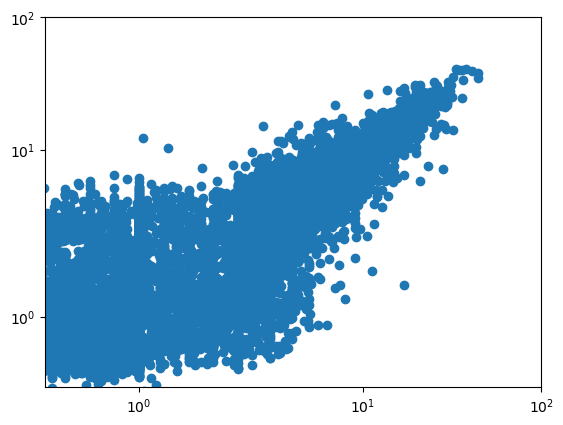

In [ ]:
plt.scatter(y,y_pred_ANN)
plt.xscale('symlog')
plt.yscale('symlog')
plt.xlim([0.05,100])
plt.ylim([0.05,100])
# plt.scatter(data_ML['pm1_a'],data_ML['pm10_o'])

## ML Review

In [347]:
# EVALUATE MODELS AND ESTIMATE PREDICTIONS
# Define your models list and model names list
models = [Lin_reg, model_DTR, model_RFR, model_ETR, model_XGBR  , model_MLPR
          ]
model_names = ['Linear.Reg','Dec.Tree.Reg', 'Ran.For.Reg', 'Ext.Trees.Reg', 'XGBoost.Reg', 'MLP.Reg'
               ]

# Evaluate the models
test_regression_result  = evaluate_models(models, model_names, x_test, y_test, 'test')
train_regression_result = evaluate_models(models, model_names, x_train, y_train, 'train')
all_regression_result   = evaluate_models(models, model_names, X, y, 'All')

# Evaluate the models
test_prediction_result  = estimate_predictions(models, model_names, x_test, y_test, 'test')
train_prediction_result = estimate_predictions(models, model_names, x_train, y_train, 'train')
# all_prediction_result   = estimate_predictions(models, model_names, X, y, 'All')
print(str(classroom_data) + '_ ' + target_col  + scene_train)

3713_ pm2.5_a_simplified v2


In [350]:
# train_prediction_result = pd.DataFrame({"y_train" : y_train.values.flatten(),
#                              "Linear Reg.":y_train_pred_LinReg.flatten(),
#                                 # "Lasso Reg." : y_train_pred_Lasso.flatten(),
#                                 # "Ridge Reg.":y_train_pred_Ridge.flatten(),
#                                 # "SGD Reg.":y_train_pred_SGR.flatten(),
#                                 # "SV Reg.":y_train_pred_SVR.flatten(),
#                                 "Dec.Tree Reg." : y_train_pred_DTR.flatten(),
#                                 "RandForest Reg.": y_train_pred_RFR.flatten(),
#                                 "Extra Trees Reg.": y_train_pred_ETR.flatten(), 
#                                 # "GradBoost Reg.":y_train_pred_GBR.flatten(),
#                                 "XGBoost Reg.":y_train_pred_XGBR.flatten(),
#                                 "MLP Reg.": y_train_pred_MLPR.flatten(),
#                                 # "ANN Reg." : y_train_pred_ANN.flatten(),
                                
#                                 },index = y_train.index
#                                )

# test_prediction_result = pd.DataFrame({"y_test" : y_test.values.flatten(),
#                             "Linear Reg.":y_test_pred_LinReg.flatten(), 
#                             # "Lasso Reg." : y_test_pred_Lasso.flatten(),
#                             # "Ridge Reg.":y_test_pred_Ridge.flatten(),
#                             # "SGD Reg.":y_test_pred_SGR.flatten(),
#                             # "SV Reg.":y_test_pred_SVR.flatten(),
#                             "Dec.Tree Reg." : y_test_pred_DTR.flatten(),
#                             "RandForest Reg.": y_test_pred_RFR.flatten(),
#                             "Extra Trees Reg.": y_test_pred_ETR.flatten(), 
#                             # "GradBoost Reg.":y_test_pred_GBR.flatten(),
#                             "XGBoost Reg.":y_test_pred_XGBR.flatten(),
#                             "TDNN Reg.": y_test_pred_MLPR.flatten(),
#                             # "ANN Reg.": y_test_pred_ANN.flatten(),
#                                 },index = y_test.index
#                                )

all_result_index = data_input[data_input['room_id']==classroom_data].sort_values(target_col).copy()
all_result_index['datetime'] = pd.to_datetime(all_result_index['datetime'])
all_result_index.set_index('datetime', inplace=True)

all_prediction_result = pd.DataFrame(index= all_result_index.index , data={
                                                                'dust_period' : all_result_index['dust_period'],
                                                                'date':all_result_index['date'],
                                                                 'time':all_result_index['time'],
                            target_col : y.values.flatten(),                                     
                            "Linear Reg.":y_pred_LinReg.flatten(), 
                            # "Lasso Reg." : y_pred_Lasso.flatten(),
                            # "Ridge Reg.":y_pred_Ridge.flatten(),
                            # "SGD Reg.":y_pred_SGR.flatten(),
                            # "SV Reg.":y_pred_SVR.flatten(),
                            "Dec.Tree Reg." : y_pred_DTR.flatten(),
                            "RandForest Reg.": y_pred_RFR.flatten(),
                            "Extra Trees Reg.": y_pred_ETR.flatten(), 
                            # "GradBoost Reg.":y_pred_GBR.flatten(),
                            "XGBoost Reg.":y_pred_XGBR.flatten(),
                            "TDNN Reg.": y_pred_MLPR.flatten(),
                            # "ANN Reg." : y_pred_ANN.flatten()
                                }, 
                               ).sort_index()

sahara_prediction_result = all_prediction_result[all_prediction_result['dust_period']=='yes']
normal_prediction_result =all_prediction_result[all_prediction_result['dust_period']=='no']

sahara_regression_result= evaluate_predictions(sahara_prediction_result.iloc[:,3:], target_col, 'sahara' )
normal_regression_result= evaluate_predictions(normal_prediction_result.iloc[:,3:], target_col, 'normal' )

In [351]:
data_importance = pd.DataFrame({"features" : xb.columns,  
                                # "Lasso Reg." : coef_Lasso,
                                # "Ridge Reg.":coef_Ridge,
                                # "SGD Reg.":coef_SGDR,
                                # "SV Reg.":coef_SVR,
                                "Dec.Tree Reg." : model_DTR.feature_importances_,
                                "RandForest Reg.": model_RFR.feature_importances_,
                                "Extra Trees Reg.": model_ETR.feature_importances_, 
                                # "GradBoost Reg.":model_GBR.feature_importances_,
                                "XGBoost Reg.":model_XGBR.feature_importances_,
                                "Linear Reg.":LinearRegression(fit_intercept=False ).fit(x_train, y_train/(y_train.max().values)).coef_.flatten()
                                 }).sort_values('RandForest Reg.', ascending = False)
data_importance

,features,Dec.Tree Reg.,RandForest Reg.,Extra Trees Reg.,XGBoost Reg.,Linear Reg.
3,pm2.5_o,0.677408,0.381299,0.294141,0.450699,0.437792
0,pm2.5_o_1,0.024865,0.325108,0.305777,0.241661,0.235997
1,pm2.5_o_2,0.155287,0.188128,0.223262,0.163342,0.206831
2,pm2.5_o_3,0.142440,0.105465,0.176820,0.144298,0.281336


## ML model save

In [352]:
import joblib
# #saving the model for the app
# joblib.dump(Lin_reg,     ML_directory + todays_date + '_Lin_reg' + '.joblib')
# # joblib.dump(Lasso,     ML_directory + todays_date + '_Lasso' + '.joblib')
# # joblib.dump(Ridge,     ML_directory + todays_date + '_Ridge' + '.joblib')
# # joblib.dump(model_GPR,  ML_directory +todays_date +  '_model_GPC' + '.joblib')
# # joblib.dump(model_KNR,  ML_directory + todays_date + '_model_KNR' + '.joblib')
# # joblib.dump(model_SVR,  ML_directory + todays_date + '_model_SVR' + '.joblib')
# joblib.dump(model_ETR,  ML_directory + todays_date + '_model_ETR' + '.joblib')
# joblib.dump(model_DTR,  ML_directory + todays_date + '_model_DTR' + '.joblib')
# joblib.dump(model_RFR,  ML_directory +  todays_date + '_model_RFR' + '.joblib')
# # joblib.dump(model_GBR,  ML_directory +  todays_date + '_model_GBR' + '.joblib')
# joblib.dump(model_MLPR, ML_directory +  todays_date + '_model_MLPR' + '.joblib')
# joblib.dump(model_XGBR, ML_directory + todays_date + '_model_XGBR' + '.joblib')

#saving the model for the app
joblib.dump(Lin_reg,     ML_directory + '_Lin_reg' + '.joblib')
# joblib.dump(Lasso,     ML_directory + todays_date + '_Lasso' + '.joblib')
# joblib.dump(Ridge,     ML_directory + todays_date + '_Ridge' + '.joblib')
# joblib.dump(model_GPR,  ML_directory +todays_date +  '_model_GPC' + '.joblib')
# joblib.dump(model_KNR,  ML_directory + todays_date + '_model_KNR' + '.joblib')
# joblib.dump(model_SVR,  ML_directory + todays_date + '_model_SVR' + '.joblib')
joblib.dump(model_ETR,  ML_directory +  '_model_ETR' + '.joblib')
joblib.dump(model_DTR,  ML_directory +  '_model_DTR' + '.joblib')
joblib.dump(model_RFR,  ML_directory +  '_model_RFR' + '.joblib')
# joblib.dump(model_GBR,  ML_directory +  todays_date + '_model_GBR' + '.joblib')
joblib.dump(model_MLPR, ML_directory +  '_model_MLPR' + '.joblib')
joblib.dump(model_XGBR, ML_directory +  '_model_XGBR' + '.joblib')

with pd.ExcelWriter(ML_directory+ '_perform data' + '.xlsx') as writer: # make one file with severel sheet

    # use to_excel function and specify the sheet_name and index to store the dataframe in specified sheet
    data_ML.to_excel(writer, sheet_name = 'main_dataset', index=True) 
    data_ML.describe(percentiles=[0.1,.25, .5, .75, .9]).to_excel(writer, sheet_name = 'df_description', index=True) 
    data_input[(data_input['room_id']==classroom_data)][airthingsDevice+weather_oslo].describe( percentiles=[0.1,.25, .5, .75, .9]).to_excel(writer, sheet_name = 'all data', index=True) 
    data_input[(data_input['room_id']==classroom_data)&(data_input['dust_period']=='no')][airthingsDevice+weather_oslo].describe( percentiles=[0.1,.25, .5, .75, .9]).to_excel(writer, sheet_name = 'normal', index=True) 
    data_input[(data_input['room_id']==classroom_data)&(data_input['dust_period']=='yes')][airthingsDevice+weather_oslo].describe( percentiles=[0.1,.25, .5, .75, .9]).to_excel(writer, sheet_name = 'dustperiod', index=True) 
    train_regression_result.to_excel(writer, sheet_name = 'ACC_train', index=True)
    test_regression_result.to_excel(writer, sheet_name = 'Acc_test', index=True) 
    all_regression_result.to_excel(writer, sheet_name = 'ACC_all', index=True)
    sahara_regression_result.to_excel(writer, sheet_name = 'ACC_sahara', index=True)
    normal_regression_result.to_excel(writer, sheet_name = 'ACC_normal', index=True)
    
    train_prediction_result.to_excel(writer, sheet_name = 'train_result', index=True) 
    test_prediction_result.to_excel(writer, sheet_name = 'test_result', index=True) 
    all_prediction_result.to_excel(writer, sheet_name = 'all_result', index=True) 
    sahara_prediction_result.to_excel(writer, sheet_name = 'sahara_result', index=True) 
    normal_prediction_result.to_excel(writer, sheet_name = 'normal_result', index=True)
    
    data_importance.to_excel(writer, sheet_name = 'data_imp', index=True)      #dont forget the index , becaus coordinate -x and -y are the index of the table
    
    MLPR_coef_df.to_excel(writer, sheet_name = 'MLPR_coef', index=True) 
    MLPR_intercept_df.to_excel(writer, sheet_name = 'MLPR_intercept', index=True)

Text(0, 0.5, 'pm2.5_a (ug/m3)')

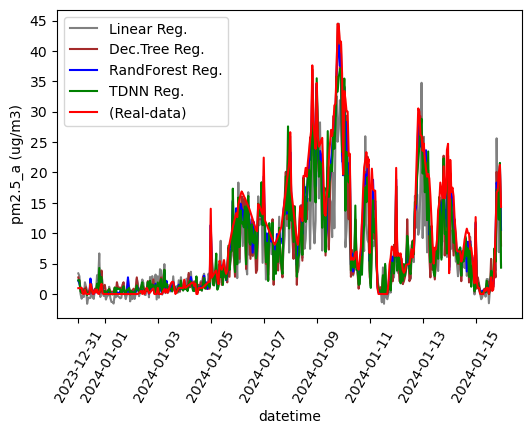

In [816]:
data_plot = all_prediction_result.copy()
# data_plot = data_plot[data_plot['date'].between('2023-08-31','2023-09-14')]
data_plot = data_plot[data_plot['date'].between('2023-12-31','2024-01-15')]
    # Plotting the median line for 'pm2.5_o'

plt.figure(figsize=(6,4))
sns.lineplot( x=data_plot.index, y=data_plot['Linear Reg.'], color='grey', label='Linear Reg.')
    # Plotting the median line for 'pm25_a'
sns.lineplot( x=data_plot.index, y=data_plot['Dec.Tree Reg.'], color='brown', label='Dec.Tree Reg.')
    # Plotting the median line for 'pm25_a'
sns.lineplot(x=data_plot.index, y=data_plot['RandForest Reg.'], color='blue', label='RandForest Reg.')
    # Plotting the median line for 'pm25_a'
sns.lineplot(x=data_plot.index, y=data_plot['TDNN Reg.'], color='green', label='TDNN Reg.')
    # Plotting the median line for 'pm25_a'

sns.lineplot( x=data_plot.index, y=data_plot[target_col], color='red', label='(Real-data) ')
    # plt.yscale('log')
plt.xticks(rotation=60)
plt.yticks(np.arange(0,50,step=5))
plt.ylabel(target_col + ' (ug/m3)')